# UK Regional Capacity Model

The model takes weather and land use data and predicts the percentage of solar PV capacity in a region. 

## Import libraries and data 

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# import dataframe_image as dfi
import statsmodels.api as sm
import seaborn as sns
from statsmodels.stats.diagnostic import normal_ad
from sklearn.linear_model import LinearRegression
import warnings
from sklearn import linear_model
from scipy import stats
import statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.stats.api as sms
from statsmodels.compat import lzip
## Data Visualization
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.linear_model import LogisticRegression
import statsmodels.api as sm
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import StratifiedKFold
from matplotlib import rc
# import pandas_profiling
from sklearn.datasets import make_regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from numpy import absolute
from pandas import read_csv
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from xgboost import XGBRegressor
import xgboost as xgb
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import geopandas
import joblib
import pycountry
from pathlib import Path
from sklearn.model_selection import GridSearchCV
from model_training_norm import plot_actual_vs_predicted_regional_capacity_by_factor, split_data_by_year, split_data_by_year_and_country, drop_columns_with_high_nan, select_columns_by_correlation, scale_capacity_to_national, convert_from_percentage_to_MW, calculate_predicted_national_capacity, gb_results, gb_scaled_results, groupby_validation, plot_actual_vs_predicted_regional_capacity, plot_actual_vs_predicted_national_capacity, plot_set, split_data_by_country  
from model_training_norm import training_results_mw, plot_shap_waterfall_by_nuts, calculate_shap_contributions_by_prefix, calculate_shap_contributions, select_columns_by_average_correlation, training_results, training_scaled_results, generate_predictions_training_data, apply_model_to_all_countries, select_columns_by_spearman_correlation, train_xgboost_model, calculate_mape_by_country
# from utilities import save_data
import mlflow
from mlflow import MlflowClient
from sklearn.model_selection import GroupKFold
import pickle

# plt.style.use('ggplot')
sns.set_palette('colorblind')

In [2]:
config = {
  'toImageButtonOptions': {
    'format': 'jpeg', # one of png, svg, jpeg, webp
    'filename': 'custom_image',
    # 'height': 1000,
    # 'width': 1000,
    'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
  }
}

## Create an mlflow experiment 

In [3]:

os.environ["MLFLOW_TRACKING_URI"] = "http://host.docker.internal:5001"


In [4]:
# # Create an experiment name, which must be unique and case sensitive
# experiment_id = mlflow.create_experiment(
#     "eu_pv_capacity_norm",
#     artifact_location=Path.cwd().joinpath("mlruns").as_uri(),
#     # tags={"version": "v1"},
# )
# experiment = mlflow.get_experiment(experiment_id)
# print(f"Name: {experiment.name}")
# print(f"Experiment_id: {experiment.experiment_id}")
# print(f"Artifact Location: {experiment.artifact_location}")
# print(f"Tags: {experiment.tags}")
# print(f"Lifecycle_stage: {experiment.lifecycle_stage}")
# print(f"Creation timestamp: {experiment.creation_time}")


## Train the model

### Model Training and Evaluation 

This script is designed to train an XGBoost model using a custom dataset, with the flexibility to choose between different cross-validation strategies. The results, including model parameters and predictions, are logged using MLflow for tracking and reproducibility.

#### Key Steps:

1. **Define Parameters and Load Data**:
   - **experiment_id**: The ID of the MLflow experiment where this run will be logged.
   - **missing_data_threshold**: The percentage threshold above which columns with missing data will be dropped.
   - **correlation_threshold**: The threshold for selecting features based on their correlation with the target variable. The options available are either Pearsons correlation, Spearmans correlation, or the average of both. 
   - **test_size**: The proportion of the dataset to be used for testing. There are cases when this is not needed such as when splitting the data by year.
   - **model_name**: A name for saving the trained model.
   - **Load Dataset**: The dataset is loaded from a CSV file.       
  
2. **Start MLflow Run**:
   - An MLflow run is started, which allows all subsequent operations to be tracked and logged.
   - **Set Tags and Autologging**: Tags can be set to categorize the run, and `mlflow.autolog()` is enabled for automatic logging.

3. **Data Preprocessing**:
   - **Categorical Columns**: Columns like `country_cd`, `nuts_cd`, and `year` are converted to categorical data types.
   - **Training Data Selection**: Only rows where the `regional_capacity_percentage` column is not missing are selected for training. 
   - **Drop Columns with High Missing Data**: Columns with more than the specified threshold of missing data are removed.
   - **Feature Selection**: Features are selected based on their correlation with the target variable using a specified correlation threshold. The functions `select_columns_by_correlation`, `select_columns_by_spearman_correlation`, or `select_columns_by_average_correlation` can be used.

4. **Data Splitting**: The dataset is divided into training and testing sets using one of two methods:

   - **By Year**: The `split_data_by_year` function groups the data by year, then splits the dataset based on the specified `test_size` or based on manually selecting `test_years`. 

5. **Model Training**:

   - **Train the Model**:
     - The model is trained using the `train_xgboost_model` function.
     - If the data was split using `split_data_by_year`, the model will be trained with GroupKFold cross-validation (`use_group_kfold=True`).
     - The training process includes tuning the hyperparameters of the model using GridSearchCV. It exhaustively searches a predefined hyperparameter space to find the optimal combination of parameters that gives the best model performance. It does this by dividing the data into training and validation sets, and evaluating the model performance for each combination of hyperparameters on the validation set. The evaluation metric used is rmse and we use 10 cv folds or groupkfold.

   - **Save the Model**:
     - After training, the model is saved as a `.pkl` file.


6. **Prediction and Evaluation**:

   - **Generate Predictions for Training and Test Data**:
     - The `generate_predictions_training_data` function is used to generate predictions for both the training and test datasets.
     - The function adds predictions to the training and test datasets, and then combines these datasets.
     - The combined data includes additional columns for predicted values and is processed to convert percentage values to absolute values in megawatts (MW).


   - **Apply Model to All Countries**:
     - The `apply_model_to_all_countries` function applies the trained model to the entire dataset.
     - This function processes the data, makes predictions, and calculates residuals (differences between actual and predicted values).
     - It also performs data scaling and converts percentages to MW, while adding country names based on ISO codes.
     - This function is applied to a dataset that includes all regions, ensuring proper scaling is performed. Using a dataset with missing regions could lead to incorrect results due to incomplete scaling.


   - **Evaluate Model Performance**:
     - Use the predictions generated by the `generate_predictions_training_data` function to assess the model's performance on both the training and test datasets. This evaluation focuses on the accuracy of the regional capacity predictions before scaling. The performance is measured using metrics such as R², MSE, MAE, and RMSE. 
     - Use the predictions generated by the `apply_model_to_all_countries` function to evaluate the model's performance on scaled regional capacity predictions and on national capacity predictions.
     - The evaluation involves comparing the sum of regional capacity predictions to the actual national capacity. The performance is measured using metrics such as R², MSE, MAE, RMSE, and MAPE.
     - The functions `training_results`, `training_scaled_results` evaluate the regoinal predictions while `gb_results`, and `gb_scaled_results` evaluate the national predictions. 


   - **Save Results and Data**:
     - Save the processed data and results to CSV files.
     - Log these files to MLflow for tracking and further analysis.



In [5]:

# Define variables
missing_data_threshold = 10
correlation_threshold = 0.5
test_size = 0.2

# import dataset
df = pd.read_csv('/gb_pv_capacity_model/data/20241127/processed/merged_nuts3_data_percentage.csv')


In [6]:
# Define the run ID
run_id = "4b2a0e8536a948e8aa478a1cbbd4533e"
# "83b2d528b1c843e68f949b68db842a19"

# Construct the base path using the run ID
base_path = f"/gb_pv_capacity_model/models/mlruns/{run_id}/artifacts/"

# Load the model
best_regressor = pickle.load(open(f"{base_path}best_estimator/model.pkl", 'rb'))

# Load the data
# regional_data = pd.read_csv(f"{base_path}regional_data.csv")
# gb_data = pd.read_csv(f"{base_path}gb_data.csv")
cv_results =  pd.read_csv(f"{base_path}cv_results.csv")

In [7]:

# set categorical columns
df['country_cd'] = df.country_cd.astype('category')
df['nuts_cd'] = df['nuts_cd'].astype('category')
df['year'] = df.year.astype('category')

# select training data set which is rows where regional capacity data is available 
training_df= df[df['regional_capacity_percentage'].notna()]
training_df

# drop columns where missing data exceeds x percent
training_df = drop_columns_with_high_nan(training_df, missing_data_threshold)
training_df

# select variables to include in the model by a correlation threshold
selected_columns, column_labels =select_columns_by_average_correlation(training_df, 'regional_capacity_percentage', threshold=correlation_threshold, include_categorical=True)

# split to training and test data 
# x_train, x_test, y_train, y_test, train_data, test_data = split_data_by_year_and_country(selected_columns, test_size=test_size, random_state=42)
x_train, x_test, y_train, y_test, train_data, test_data = split_data_by_year(selected_columns, target_column='regional_capacity_percentage', test_years=[2021, 2022, 2023], random_seed=42)
# x_train, x_test, y_train, y_test, train_data, test_data = split_data_by_country(selected_columns, target_column='regional_capacity_percentage', test_country='BE', random_seed=42)


y_test_pred, y_train_pred, regional_data = generate_predictions_training_data(best_regressor, x_train, x_test, train_data, test_data, training_df)

gb_data = apply_model_to_all_countries(best_regressor, df, column_labels, regional_data)





/gb_pv_capacity_model/models/model_training_norm.py:271: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  train_data = pd.concat([train_data, year_data])
/gb_pv_capacity_model/models/model_training_norm.py:271: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  train_data = pd.concat([train_data, year_data])
/gb_pv_capacity_model/models/model_training_norm.py:269: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer e

In [8]:
cv_results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_max_depth,param_n_estimators,params,split0_test_score,split1_test_score,...,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,split10_test_score,mean_test_score,std_test_score,rank_test_score
0,2.324678,0.095464,0.010326,0.001115,0.01,3,500,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.910262,0.914050,...,0.903594,0.889705,0.856898,0.874032,0.853069,0.808728,0.429640,0.841296,0.133799,213
1,2.966634,0.244928,0.011886,0.006749,0.01,3,600,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.915632,0.919394,...,0.911869,0.892875,0.864248,0.879902,0.850769,0.812138,0.422548,0.845438,0.137617,101
2,3.592976,0.293451,0.011281,0.002272,0.01,3,700,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.920958,0.926432,...,0.917560,0.896032,0.867988,0.884143,0.850409,0.816101,0.413598,0.848892,0.141772,52
3,3.601251,0.151018,0.011404,0.002558,0.01,3,800,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.924254,0.930182,...,0.922317,0.900039,0.870867,0.886155,0.849009,0.820030,0.404646,0.851232,0.145486,41
4,4.688822,0.337448,0.012824,0.003891,0.01,3,900,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.927041,0.932375,...,0.926100,0.903250,0.874402,0.888930,0.847816,0.824299,0.392803,0.852841,0.149715,37
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
523,1.645888,0.034148,0.006590,0.000663,1.00,10,600,"{'learning_rate': 1, 'max_depth': 10, 'n_estim...",0.902589,0.946718,...,0.938649,0.917901,0.907461,0.828211,0.799905,0.782322,0.352275,0.841210,0.164704,214
524,1.982777,0.094226,0.008125,0.001747,1.00,10,700,"{'learning_rate': 1, 'max_depth': 10, 'n_estim...",0.902589,0.946718,...,0.938649,0.917901,0.907461,0.828211,0.799905,0.782322,0.352275,0.841210,0.164704,214
525,2.261830,0.139669,0.006957,0.000677,1.00,10,800,"{'learning_rate': 1, 'max_depth': 10, 'n_estim...",0.902589,0.946718,...,0.938649,0.917901,0.907461,0.828211,0.799905,0.782322,0.352275,0.841210,0.164704,214
526,2.471196,0.181143,0.006493,0.000235,1.00,10,900,"{'learning_rate': 1, 'max_depth': 10, 'n_estim...",0.902589,0.946718,...,0.938649,0.917901,0.907461,0.828211,0.799905,0.782322,0.352275,0.841210,0.164704,214


## Feature importance
- ”weight” is the number of times a feature appears in a tree. This can favourize numerical and high cardinality features.
- ”gain” is the average gain of splits which use the feature
- ”cover” is the average coverage of splits which use the feature where coverage is defined as the number of samples affected by the split

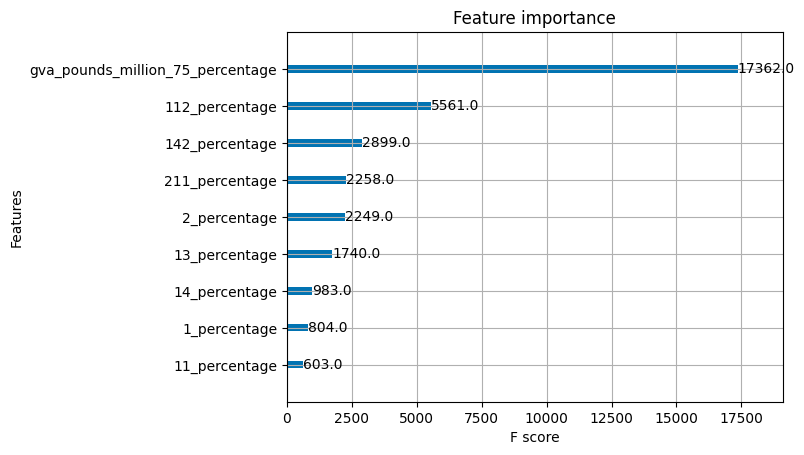

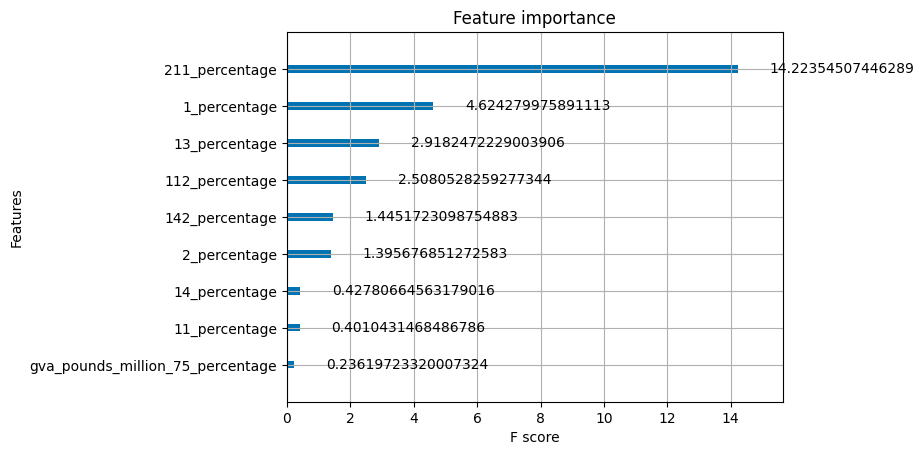

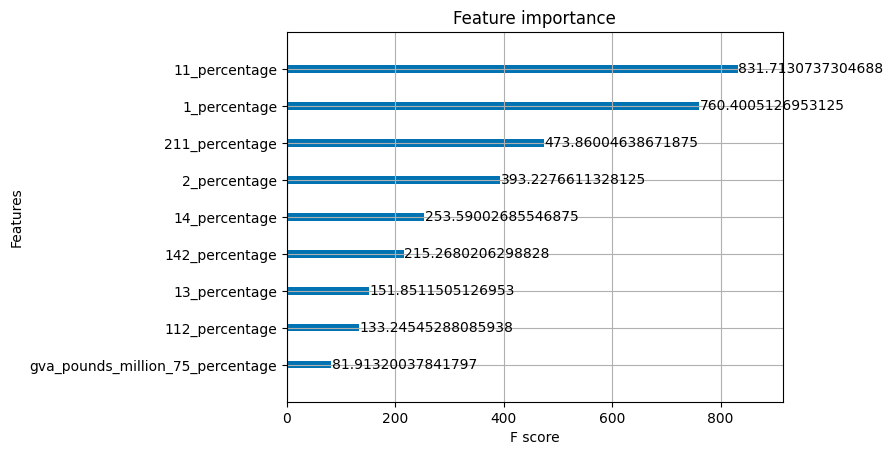

In [9]:
from xgboost import plot_importance

plot_importance(best_regressor,  importance_type='weight')
plt.show()

plot_importance(best_regressor,  importance_type='gain')
plt.show()

plot_importance(best_regressor,  importance_type='cover')
plt.show()


In [10]:
# the number of occurrences of the feature in splits: integers greater than 0 (features not participating in splits are omitted)
# this is the one plotted in the xgboost auto plot
best_regressor.get_booster().get_score(importance_type='weight')

{'112_percentage': 5561.0,
 '142_percentage': 2899.0,
 '211_percentage': 2258.0,
 '11_percentage': 603.0,
 '13_percentage': 1740.0,
 '14_percentage': 983.0,
 '1_percentage': 804.0,
 '2_percentage': 2249.0,
 'gva_pounds_million_75_percentage': 17362.0}

- Feature Importance from Mean Decrease in Impurity (MDI) (training set)
- Permutation Feature Importance (test set)

/tmp/ipykernel_2376/2869986326.py:23: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


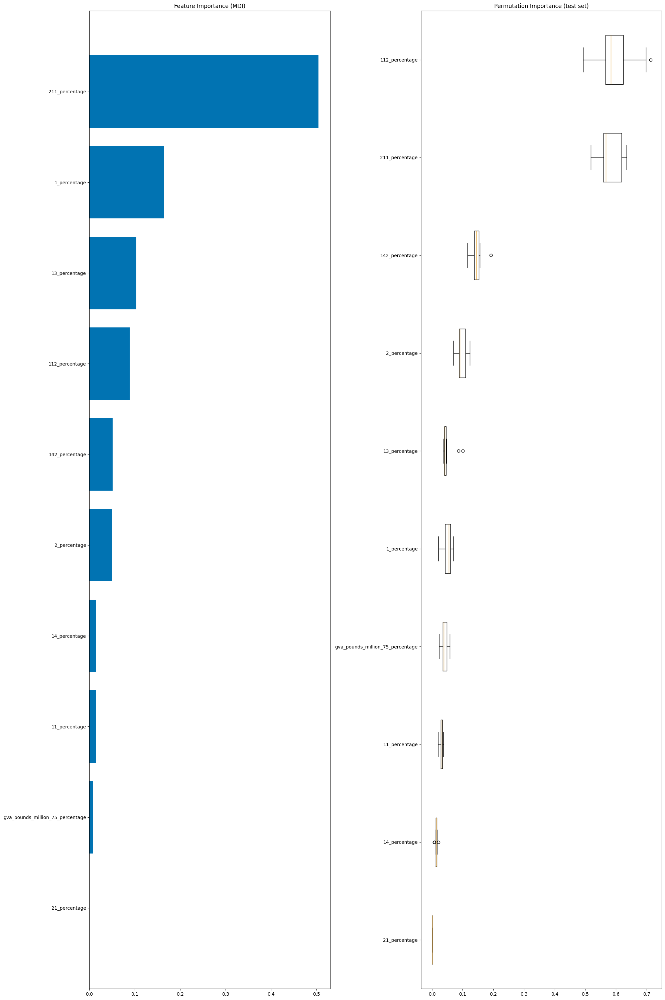

In [11]:
# https://scikit-learn.org/stable/auto_examples/inspection/plot_permutation_importance.html#sphx-glr-auto-examples-inspection-plot-permutation-importance-py
from sklearn.inspection import permutation_importance
feature_importance = best_regressor.feature_importances_
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + 0.5
fig = plt.figure(figsize=(20, 30))
plt.subplot(1, 2, 1)
plt.barh(pos, feature_importance[sorted_idx], align="center")
plt.yticks(pos, np.array(x_train.columns)[sorted_idx])
plt.title("Feature Importance (MDI)")


# fig = px.bar(x=feature_importance[sorted_idx], y=np.array(X_names1)[sorted_idx], orientation='h')
# fig.update_layout(title='Feature Importance (MDI)', xaxis_title='Importance')
# fig.show()


result = permutation_importance(
    best_regressor, x_test, y_test, n_repeats=10, random_state=42
)
sorted_idx = result.importances_mean.argsort()
plt.subplot(1, 2, 2)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(x_test.columns)[sorted_idx],
)
plt.title("Permutation Importance (test set)")
fig.tight_layout()
plt.show()


In [12]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from sklearn.inspection import permutation_importance

# Calculate permutation importances
feature_importance = best_regressor.feature_importances_
sorted_idx = np.argsort(feature_importance)

# Create a horizontal bar plot for Feature Importance (MDI)
fig1 = px.bar(
    x=feature_importance[sorted_idx],
    y=np.array(x_test.columns)[sorted_idx],
    orientation='h',
    title='Feature Importance (MDI)',
    labels={'x': 'Importance', 'y': ''}
)

# Increase the figure size for the Feature Importance (MDI) plot
fig1.update_layout(
    width=800,  # Set the width to your desired value
    height=900  # Set the height to your desired value
)

# Create a Permutation Importance plot
result = permutation_importance(
    best_regressor, x_test, y_test, n_repeats=10, random_state=42
)
sorted_idx = result.importances_mean.argsort()

fig2 = go.Figure()

for i in range(len(sorted_idx)):
    feature_name = np.array(x_test.columns)[sorted_idx[i]]
    feature_importances = result.importances[sorted_idx[i]]
    
    fig2.add_trace(
        go.Box(
            y=[feature_name] * len(feature_importances),
            x=feature_importances,
            orientation='h',
            # name=feature_name
        )
    )

fig2.update_layout(
    title='Permutation Importance (test set)',
    xaxis_title='Importance',
    yaxis_title=''
)

# Increase the figure size for the Permutation Importance plot
fig2.update_layout(
    width=800,  # Set the width to your desired value
    height=900  # Set the height to your desired value
)

# Display the plots
fig1.show(config=config)
fig2.show(config=config)


In [13]:
import numpy as np
import plotly.express as px
from sklearn.inspection import permutation_importance

# Calculate permutation importances
feature_importance = best_regressor.feature_importances_
sorted_idx = np.argsort(feature_importance)

# Select the top 10 features
top_n = 10
selected_feature_indices = sorted_idx[-top_n:]
selected_feature_importance = feature_importance[selected_feature_indices]
selected_feature_names = np.array(x_test.columns)[selected_feature_indices]

# Create a horizontal bar plot for Feature Importance (MDI) with the top 10 features
fig1 = px.bar(
    x=selected_feature_importance,
    y=selected_feature_names,
    orientation='h',
    title='Feature Importance (MDI): Top 10 Features',
    labels={'x': 'Importance', 'y': ''}
)

# Increase the figure size for the Feature Importance (MDI) plot
fig1.update_layout(
    width=800,  # Set the width to your desired value
    height=600  # Set the height to your desired value
)

# Display the plot
fig1.show(config=config)


In [14]:
# import shap
# # https://www.aidancooper.co.uk/a-non-technical-guide-to-interpreting-shap-analyses/

# # SHAP values
# explainer = shap.TreeExplainer(best_regressor)
# # shap_values = explainer.shap_values(x_train)
# # shap.summary_plot(shap_values, x_train)
# # shap.summary_plot(shap_values, x_train, plot_type="bar")

# shap_values = explainer.shap_values(x_test)
# shap.summary_plot(shap_values, x_test)
# shap.summary_plot(shap_values, x_test, plot_type="bar")

# # Compute the mean absolute SHAP values for each feature
# mean_shap_values = np.abs(shap_values).mean(axis=0)

# # Create a pandas DataFrame for better visualization
# shap_summary_df = pd.DataFrame({
#     'Feature': x_test.columns,
#     'Mean SHAP Value': mean_shap_values
# }).sort_values(by='Mean SHAP Value', ascending=False)

# # Print the summary of SHAP values
# print(shap_summary_df)

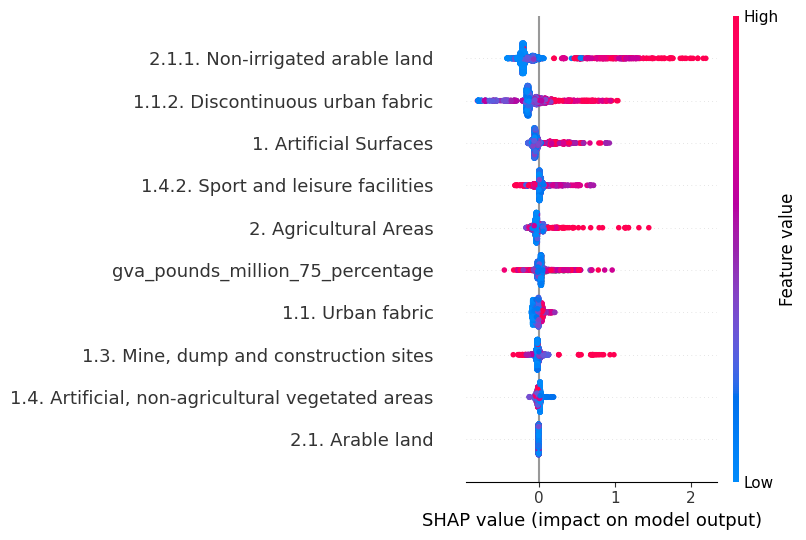

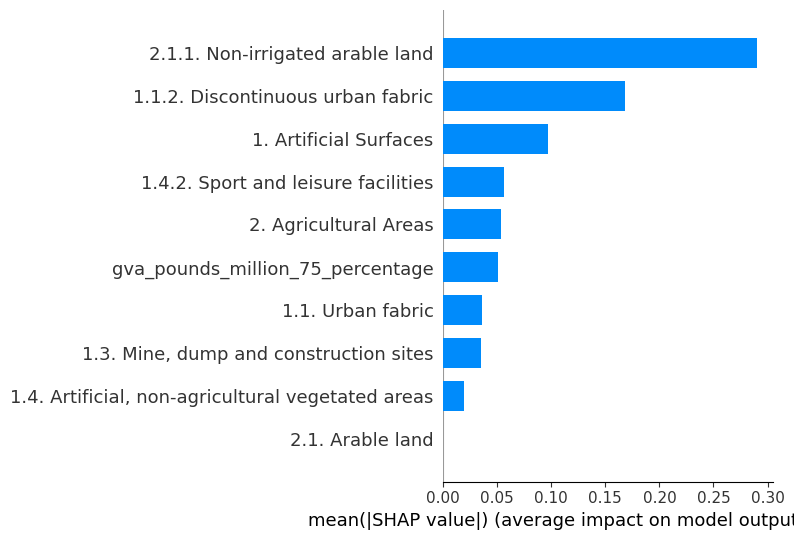

                                             Feature  Mean SHAP Value
2                   2.1.1. Non-irrigated arable land         0.290178
0                  1.1.2. Discontinuous urban fabric         0.168572
7                             1. Artificial Surfaces         0.097397
1                1.4.2. Sport and leisure facilities         0.056736
8                              2. Agricultural Areas         0.053832
9                   gva_pounds_million_75_percentage         0.051224
3                                  1.1. Urban fabric         0.036352
4             1.3. Mine, dump and construction sites         0.035456
5  1.4. Artificial, non-agricultural vegetated areas         0.019565
6                                   2.1. Arable land         0.000000
                                              Factor  Mean SHAP Value  \
2                   2.1.1. Non-irrigated arable land         0.290178   
0                  1.1.2. Discontinuous urban fabric         0.168572   
7          

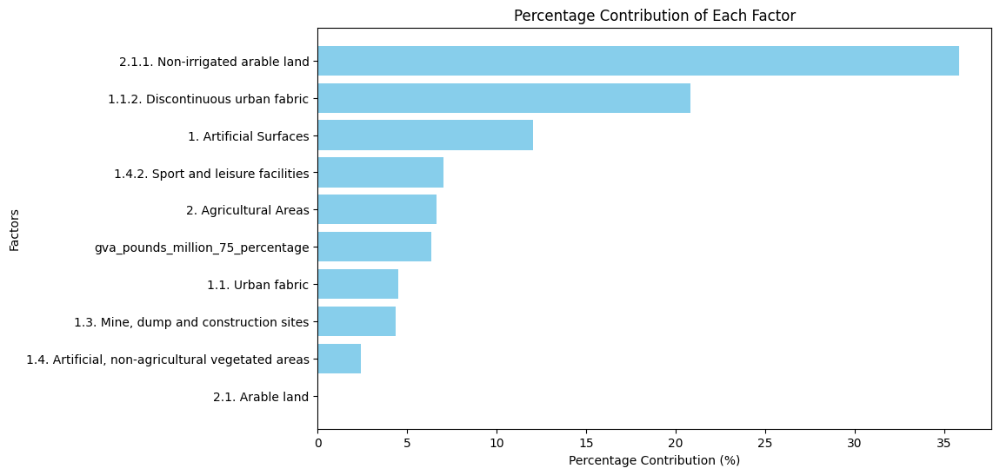

In [15]:
# this is the one i am using in the paper because because i want the shap values for the entire dataset
import shap
# https://www.aidancooper.co.uk/a-non-technical-guide-to-interpreting-shap-analyses/

# Read the CSV file with land categories
dfc = pd.read_csv("/gb_pv_capacity_model/data_analysis/land categories.csv")

# Create a mapping from 'code' to 'Land Type'
col_map = dict(zip(dfc['code'], dfc['Land Type']))

# SHAP values
explainer = shap.TreeExplainer(best_regressor)
x_train_test = pd.concat([x_train, x_test])
x_train_test

# Rename the columns in your DataFrame based on this mapping
x_train_test.rename(columns=col_map, inplace=True)

shap_values = explainer.shap_values(x_train_test)
shap.summary_plot(shap_values, x_train_test)
shap.summary_plot(shap_values, x_train_test, plot_type="bar")

# Compute the mean absolute SHAP values for each feature
mean_shap_values = np.abs(shap_values).mean(axis=0)

# Create a pandas DataFrame for better visualization
shap_summary_df = pd.DataFrame({
    'Feature': x_train_test.columns,
    'Mean SHAP Value': mean_shap_values
}).sort_values(by='Mean SHAP Value', ascending=False)

# Print the summary of SHAP values
print(shap_summary_df)

# Assuming `mean_shap_values` contains the mean SHAP values for each factor
# Calculate the total absolute contribution of all factors
total_contribution = np.sum(np.abs(mean_shap_values))

# Calculate the percentage contribution for each factor
percentage_contributions = (np.abs(mean_shap_values) / total_contribution) * 100

# Create a DataFrame 
percentage_df = pd.DataFrame({
    'Factor': x_train_test.columns.tolist(),
    'Mean SHAP Value': mean_shap_values,
    'Percentage Contribution (%)': percentage_contributions
})

# Sort by percentage contribution 
percentage_df = percentage_df.sort_values(by='Percentage Contribution (%)', ascending=False)

# Display the table
print(percentage_df)

# plot the contributions as a bar chart
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.barh(percentage_df['Factor'], percentage_df['Percentage Contribution (%)'], color='skyblue')
plt.xlabel('Percentage Contribution (%)')
plt.ylabel('Factors')
plt.title('Percentage Contribution of Each Factor')
plt.gca().invert_yaxis()  # Invert y-axis to show the largest contributor at the top
plt.show()


In [16]:
calculate_shap_contributions_by_prefix(shap_values, x_train_test, feature_prefix="1")
calculate_shap_contributions_by_prefix(shap_values, x_train_test, feature_prefix="2")
calculate_shap_contributions_by_prefix(shap_values, x_train_test, feature_prefix="gva")


Total contribution of factors starting with '1': 0.41407880187034607
Percentage contribution of factors starting with '1': 51%
                                             Feature  Mean SHAP Value
0                  1.1.2. Discontinuous urban fabric         0.168572
5                             1. Artificial Surfaces         0.097397
1                1.4.2. Sport and leisure facilities         0.056736
2                                  1.1. Urban fabric         0.036352
3             1.3. Mine, dump and construction sites         0.035456
4  1.4. Artificial, non-agricultural vegetated areas         0.019565
Total contribution of factors starting with '2': 0.34400948882102966
Percentage contribution of factors starting with '2': 43%
                            Feature  Mean SHAP Value
0  2.1.1. Non-irrigated arable land         0.290177
2             2. Agricultural Areas         0.053832
1                  2.1. Arable land         0.000000
Total contribution of factors starting with 

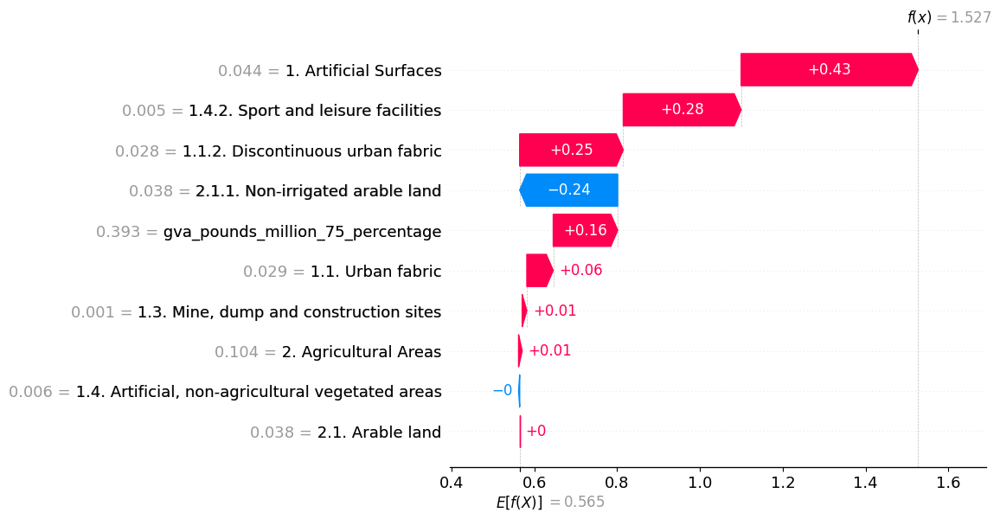

In [22]:
plot_shap_waterfall_by_nuts(regional_data, shap_values, x_train_test, explainer, desired_nuts_cd="UKE31", start_year=2010, end_year=2023, save_figure=False, file_path="FIG8.eps")


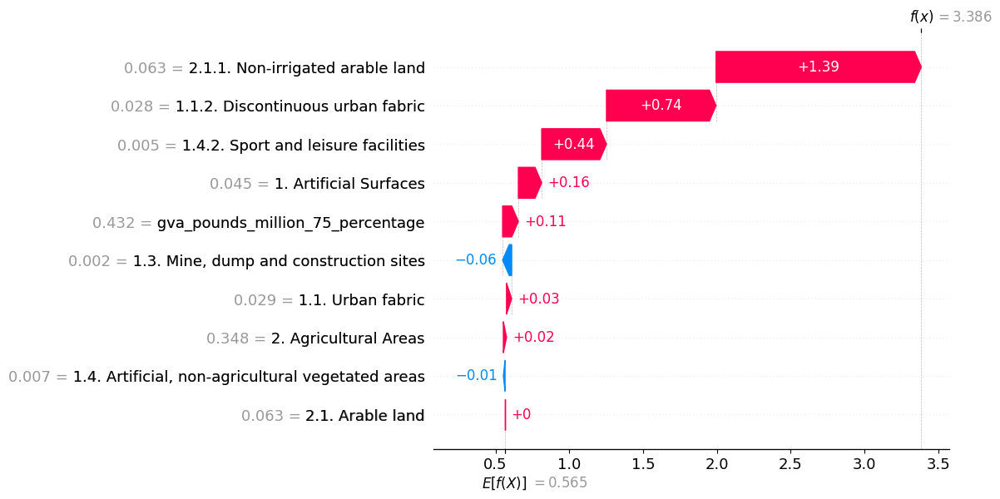

In [24]:
plot_shap_waterfall_by_nuts(regional_data, shap_values, x_train_test, explainer, desired_nuts_cd="UKH12", start_year=2010, end_year=2023, save_figure=False, file_path="FIG7.eps")


                                              Factor  Mean SHAP Value  \
7                             1. Artificial Surfaces         0.427547   
1                1.4.2. Sport and leisure facilities         0.284581   
0                  1.1.2. Discontinuous urban fabric         0.250121   
9                   gva_pounds_million_75_percentage         0.155651   
3                                  1.1. Urban fabric         0.063787   
4             1.3. Mine, dump and construction sites         0.011166   
8                              2. Agricultural Areas         0.008714   
6                                   2.1. Arable land         0.000000   
5  1.4. Artificial, non-agricultural vegetated areas        -0.002709   
2                   2.1.1. Non-irrigated arable land        -0.236712   

   Percentage Contribution (%)  
7                    29.670408  
1                    19.749018  
0                    17.357597  
9                    10.801661  
3                     4.426645 

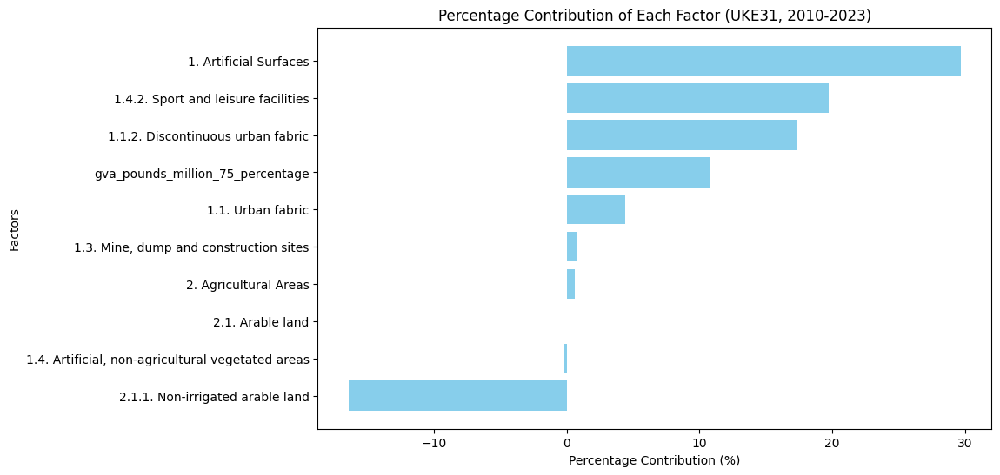

In [25]:
calculate_shap_contributions(regional_data, shap_values, x_train_test, desired_nuts_cd="UKE31", start_year=2010, end_year=2023)

                                              Factor  Mean SHAP Value  \
2                   2.1.1. Non-irrigated arable land         1.390961   
0                  1.1.2. Discontinuous urban fabric         0.742600   
1                1.4.2. Sport and leisure facilities         0.438954   
7                             1. Artificial Surfaces         0.158098   
9                   gva_pounds_million_75_percentage         0.106757   
3                                  1.1. Urban fabric         0.034688   
8                              2. Agricultural Areas         0.021542   
6                                   2.1. Arable land         0.000000   
5  1.4. Artificial, non-agricultural vegetated areas        -0.011469   
4             1.3. Mine, dump and construction sites        -0.061345   

   Percentage Contribution (%)  
2                    46.890305  
0                    25.033581  
1                    14.797470  
7                     5.329603  
9                     3.598862 

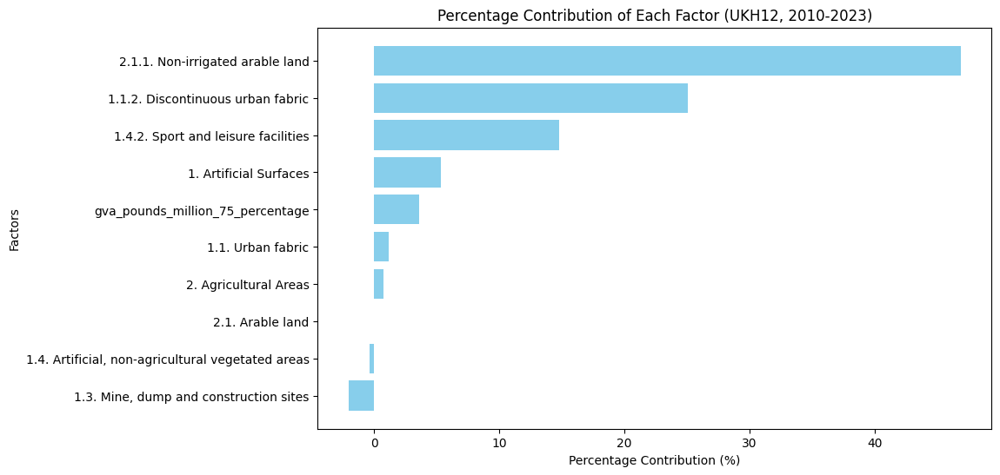

In [26]:
calculate_shap_contributions(regional_data, shap_values, x_train_test, desired_nuts_cd="UKH12", start_year=2010, end_year=2023)

### Number of NUTS regions per country in the data set 

In [17]:
unique_counts = df.groupby('country_cd')['nuts_cd'].nunique()
print(unique_counts)

country_cd
UK    168
Name: nuts_cd, dtype: int64


/tmp/ipykernel_18471/4073528657.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



### Number of NUTS regions per country in the training data set 

In [27]:
# Check the number of nuts regions wihtin the training data. 
unique_counts = training_df.groupby('country_cd')['nuts_cd'].nunique()
print(unique_counts)

country_cd
UK    168
Name: nuts_cd, dtype: int64


/tmp/ipykernel_1985/884881203.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [28]:
# Number of data points available in each year
counts = training_df['year'].value_counts()
print(counts)

year
2010    168
2011    168
2012    168
2013    168
2014    168
2015    168
2016    168
2017    168
2018    168
2019    168
2020    168
2021    168
2022    168
2023    168
Name: count, dtype: int64


In [20]:
# number of data points available in each country 
country_counts = training_df['country_cd'].value_counts()
print(country_counts)

country_cd
UK    2352
Name: count, dtype: int64


## Results

### The error metrics for predicting the regional capacity percentage 

In [13]:
training_results(y_train, y_test, y_test_pred, y_train_pred, log_to_mlflow=False)

R2 training score is  0.9746747259200231
R2 test score is  0.9025046291400789
The MSE is: 0.06767340187170952
The MAE is: 0.13038301344008305
RMSE is: 0.2601411191482606
MAPE is: 30857346666301.26


### Plotting actual vs predicted

#### Actual vs predicted regional capacity for training set

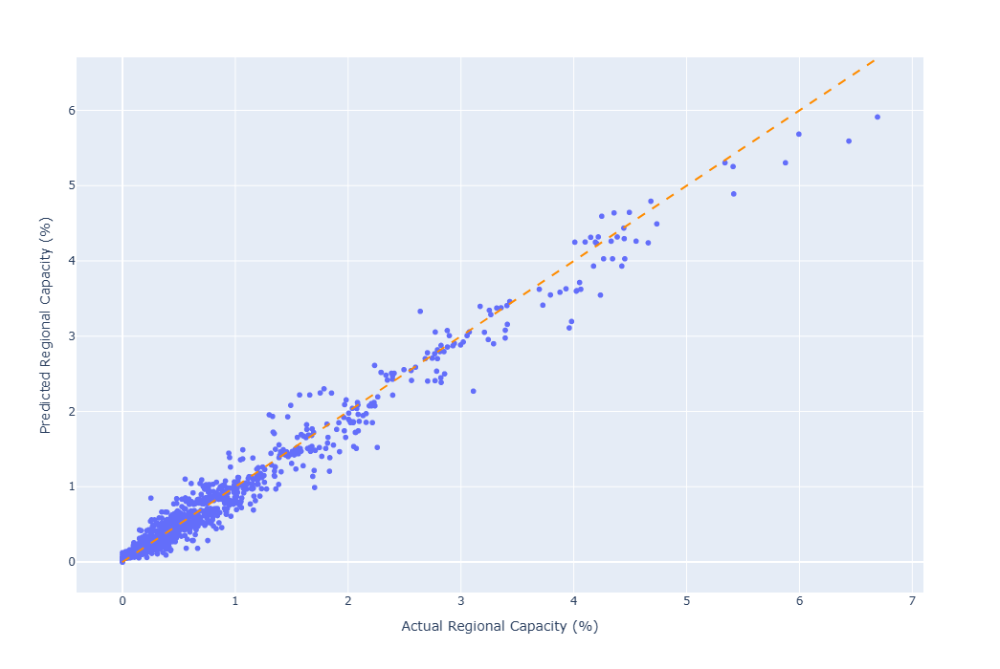

In [10]:
plot_set(regional_data, 'train', capacity_unit='percentage')

#### Actual vs predicted regional capacity for test set

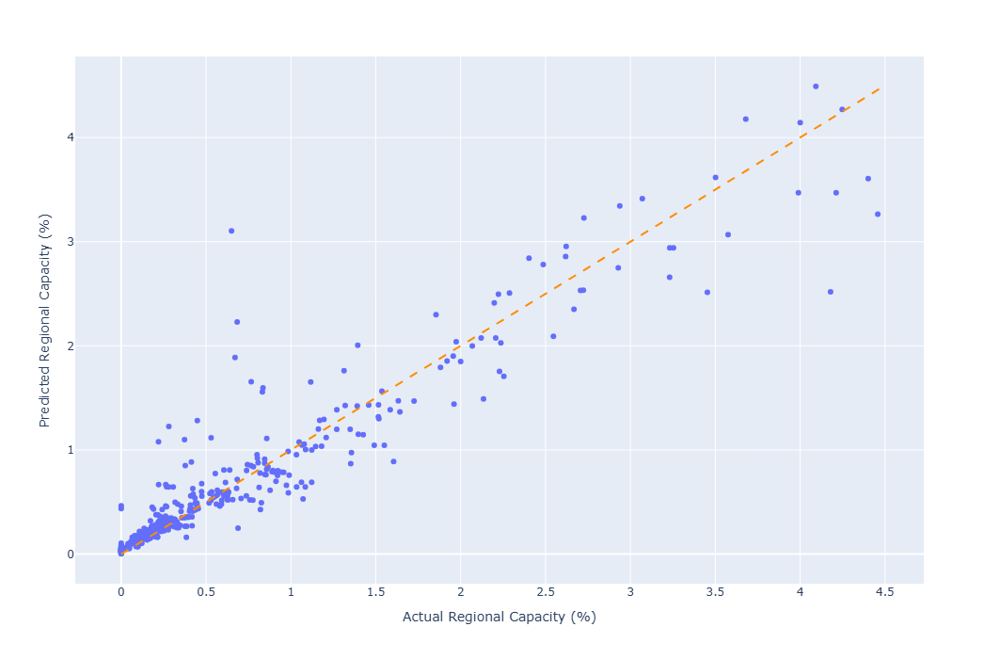

In [11]:
plot_set(regional_data, 'test', capacity_unit='percentage')

### Scaling regional capacity so it adds to the national capacity 

In [12]:
training_scaled_results(gb_data, log_to_mlflow=False)

Error metrics for the entire dataset: 
R2 score is  0.9594034782682841
The MSE is: 0.029682748549836838
The MAE is: 0.09784960040426585
RMSE is: 0.17228682059239714
MAPE is: 23313208219077.066
Error metrics for the test points: 
R2 test score is  0.907278555485376
The MSE is: 0.0643597282765252
The MAE is: 0.12848485074478405
RMSE is: 0.2536921919896732
MAPE is: 30262469172858.22


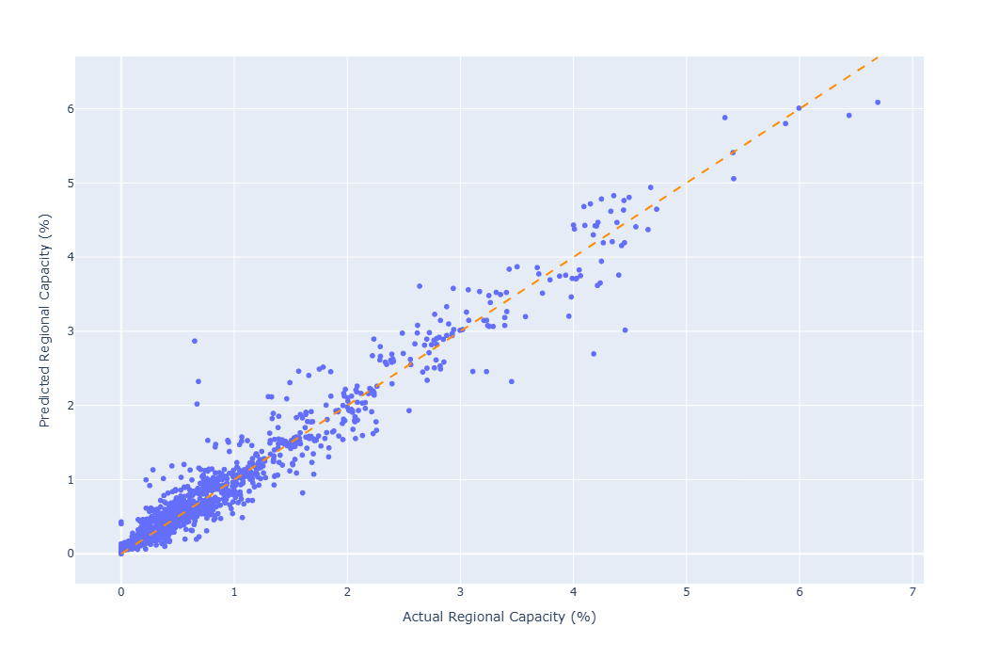

In [41]:
plot_actual_vs_predicted_regional_capacity(gb_data, capacity_unit='percentage', scaled=True)

### Residual Analysis

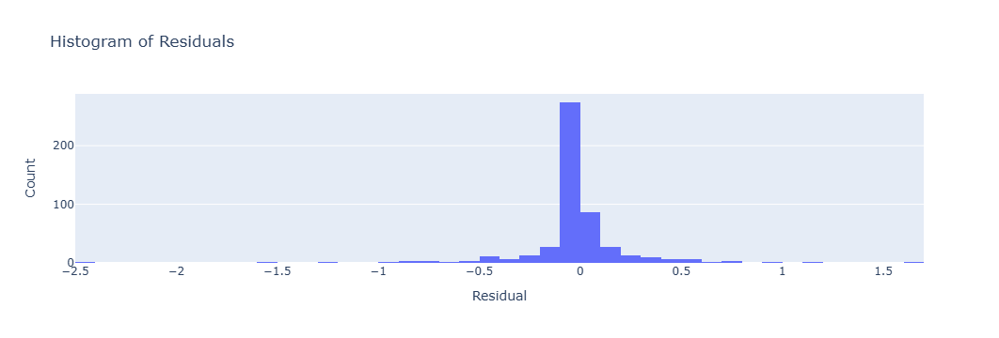

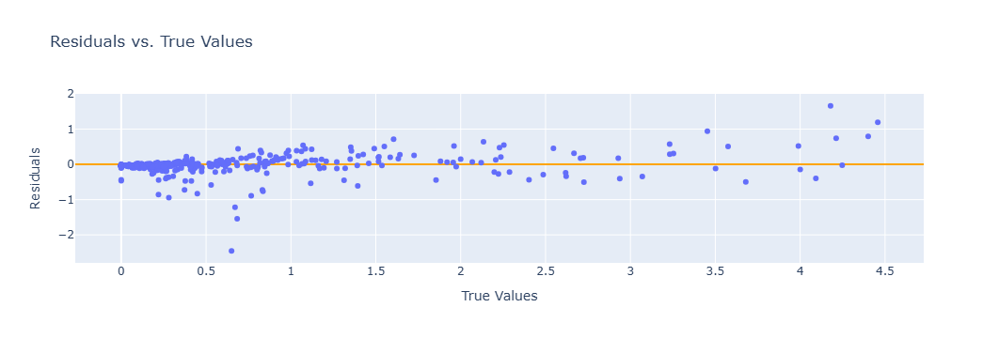

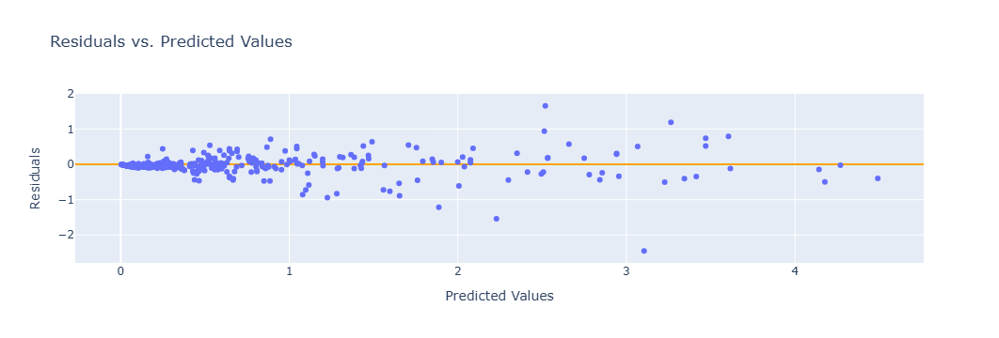

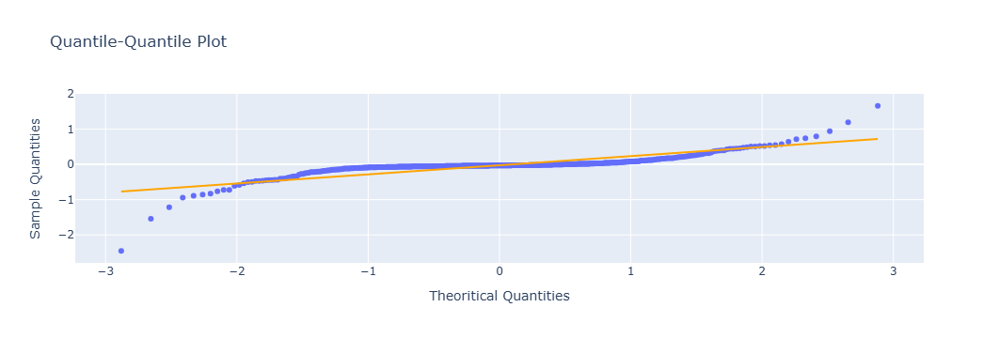

In [14]:
import plotly.graph_objs as go
from statsmodels.graphics.gofplots import qqplot
from chart_studio.plotly import plot, iplot
import plotly.offline as pyo
# pyo.init_notebook_mode(connected=True)
# pyo.init_notebook_mode()

import chart_studio.plotly as py

# Calculate residuals
residuals = y_test - y_test_pred

# Plot histogram of residuals
hist_trace = go.Histogram(x=residuals, nbinsx=50, marker_color='#636efa')
layout = go.Layout(title='Histogram of Residuals',
                   xaxis_title='Residual',
                   yaxis_title='Count')
fig = go.Figure(data=hist_trace, layout=layout)
fig.show(config=config)

# Plot residuals against y_test
scatter_trace = go.Scatter(x=y_test, y=residuals, mode='markers', marker_color='#636efa')
layout = go.Layout(title='Residuals vs. True Values',
                   xaxis_title='True Values',
                   yaxis_title='Residuals')
layout.yaxis.zeroline = True
layout.yaxis.zerolinecolor = 'orange'
layout.yaxis.zerolinewidth = 2
# layout.yaxis.zerolinetype = 'dashed'
fig = go.Figure(data=scatter_trace, layout=layout)
fig.show(config=config)

# Plot residuals against y_pred
scatter_trace = go.Scatter(x=y_test_pred, y=residuals, mode='markers', marker_color='#636efa')
layout = go.Layout(title='Residuals vs. Predicted Values',
                   xaxis_title='Predicted Values',
                   yaxis_title='Residuals')
layout.yaxis.zeroline = True
layout.yaxis.zerolinecolor = 'orange'
layout.yaxis.zerolinewidth = 2
# layout.yaxis.zerolinetype = 'dashed'
fig = go.Figure(data=scatter_trace, layout=layout)
fig.show(config=config)



qqplot_data = qqplot(residuals, line='s').gca().lines
plt.close()

fig = go.Figure()

fig.add_trace({
    'type': 'scatter',
    'x': qqplot_data[0].get_xdata(),
    'y': qqplot_data[0].get_ydata(),
    'mode': 'markers',
    'marker': {
        # 'color': '#19d3f3'
    }
})

fig.add_trace({
    'type': 'scatter',
    'x': qqplot_data[1].get_xdata(),
    'y': qqplot_data[1].get_ydata(),
    'mode': 'lines',
    'line': {
        'color': 'orange'
    }

})


fig['layout'].update({
    'title': 'Quantile-Quantile Plot',
    'xaxis': {
        'title': 'Theoritical Quantities',
        'zeroline': False
    },
    'yaxis': {
        'title': 'Sample Quantities'
    },
    'showlegend': False,
    # 'width': 800,
    # 'height': 700,
})

pyo.iplot(fig, config=config)
# iplot(fig, filename='normality-QQ')
# py.iplot(fig, filename='normality-QQ')

### Applying the model to EU countries

- Apply the model to estimate the regional capacity which is a percentage of the national capacity
- Multiply the capacity percentage by the national capacity to get the reigonal capacity in MW
- Sum the estimated capacity for all the regions in a country and compare to the national capacity
- Scale the regional capacity so the sum of the capacity for all the regions equals the national capacity

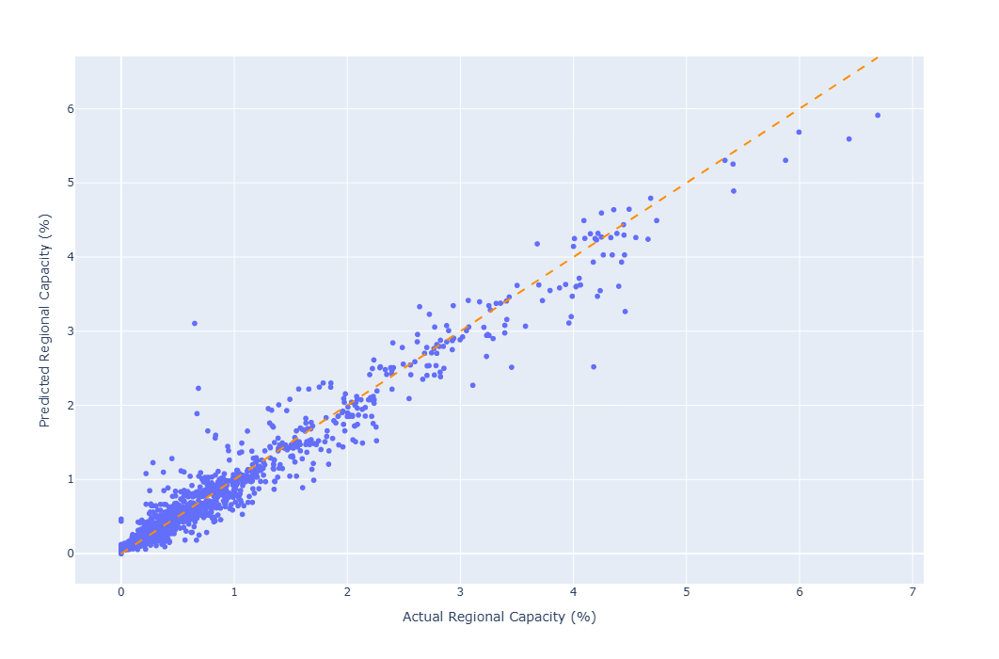

In [15]:
plot_actual_vs_predicted_regional_capacity(gb_data, capacity_unit='percentage', scaled=False)

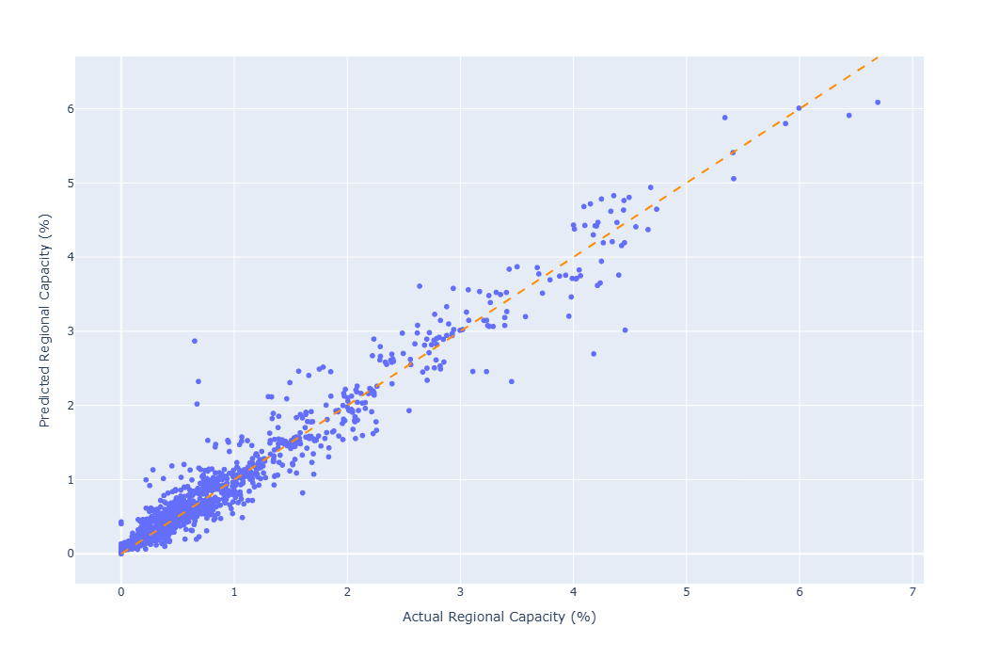

In [16]:
plot_actual_vs_predicted_regional_capacity(gb_data, capacity_unit='percentage', scaled=True)

### Actual vs predicted national capacity before scaling

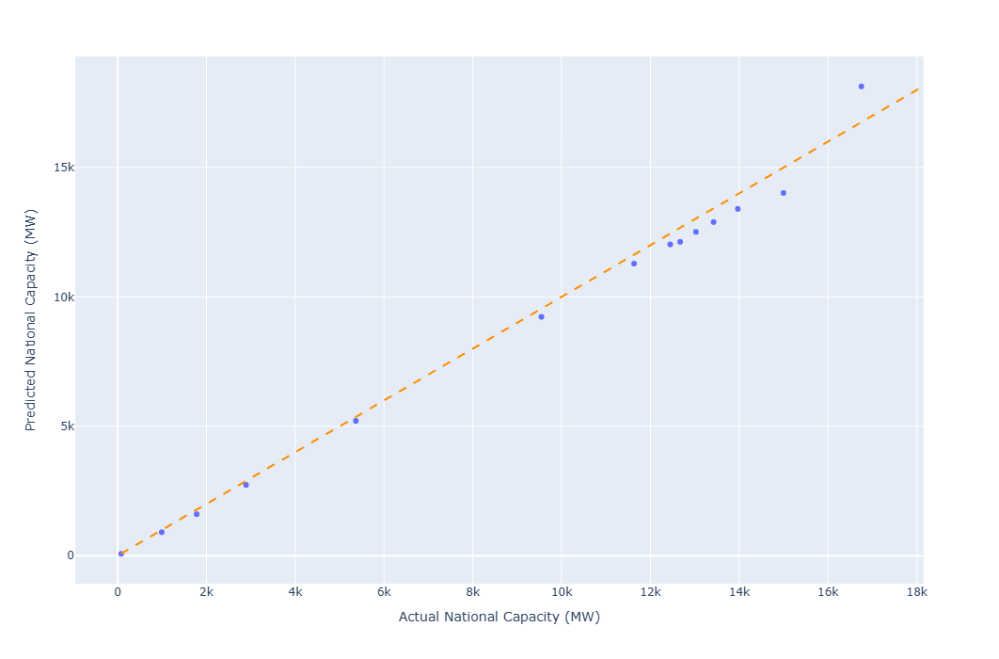

In [17]:
plot_actual_vs_predicted_national_capacity(gb_data, by_factor=False, scaled=False)


### Actual vs predicted national capacity after scaling

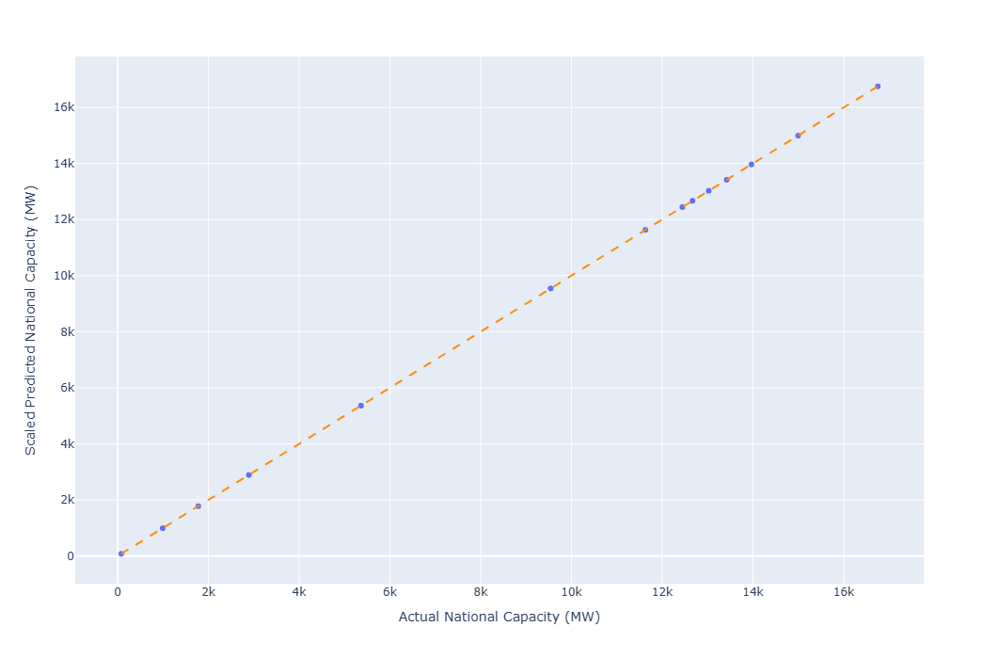

In [18]:
plot_actual_vs_predicted_national_capacity(gb_data, by_factor=False, scaled=True)


In [21]:
mape_by_year_country, mape_by_country = calculate_mape_by_country(gb_data, 'country', 'national_capacity_mwp', 'predicted_national_capacity_mwp')
mape_by_year_country
mape_by_country

/gb_pv_capacity_model/models/model_training_norm.py:805: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/gb_pv_capacity_model/models/model_training_norm.py:811: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,country,Average_MAPE
0,United Kingdom,5.4


### Residual by region

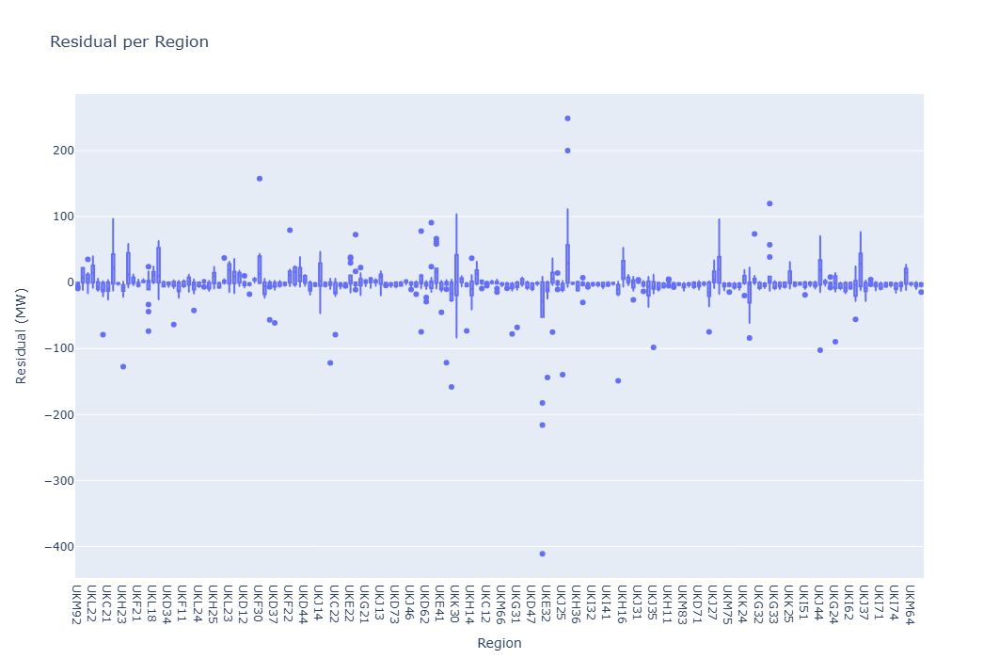

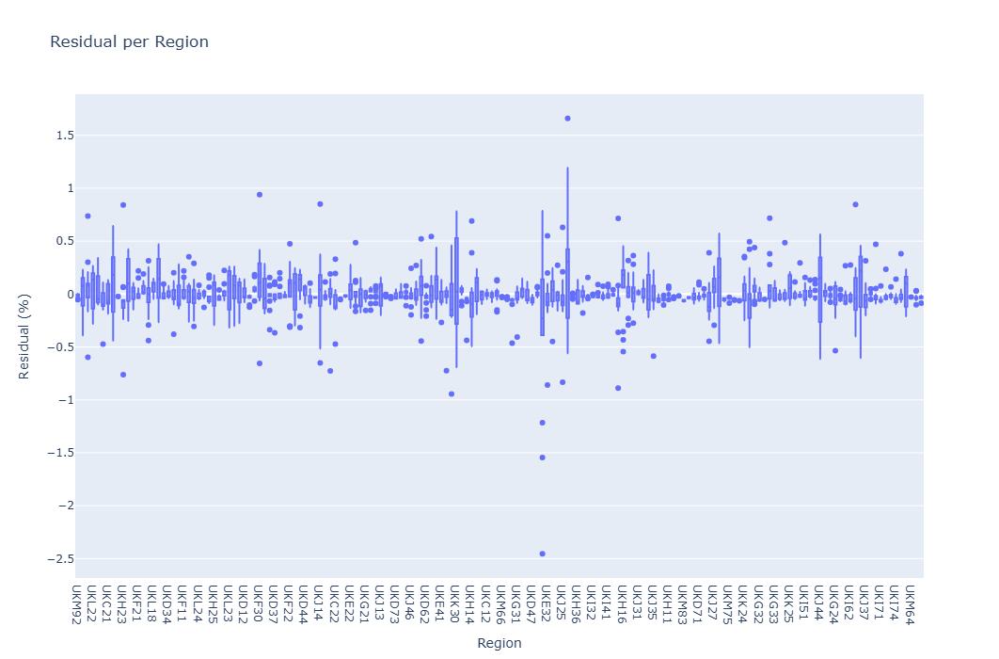

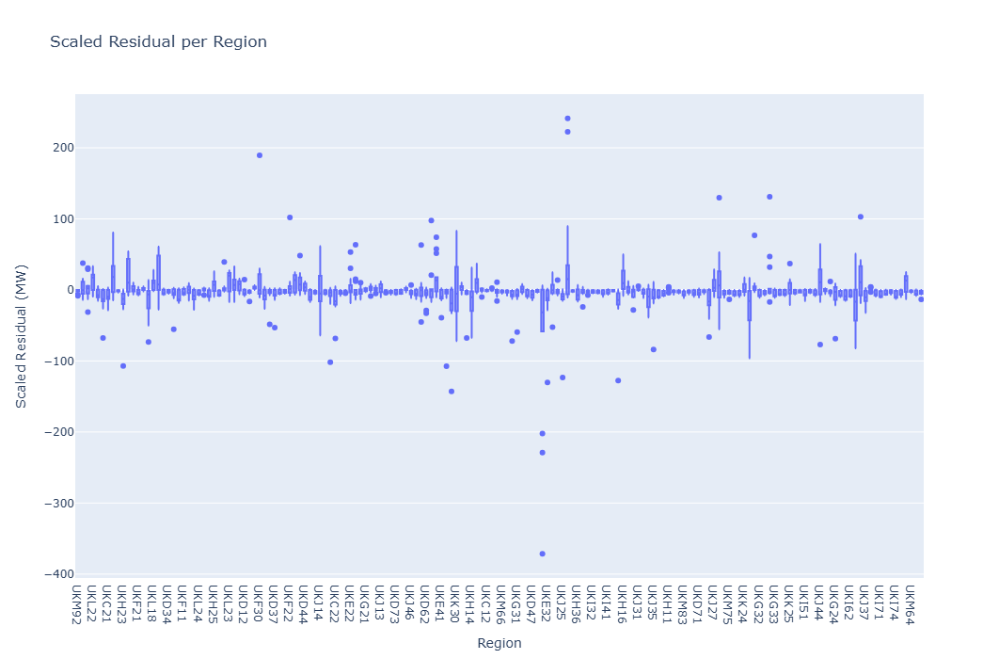

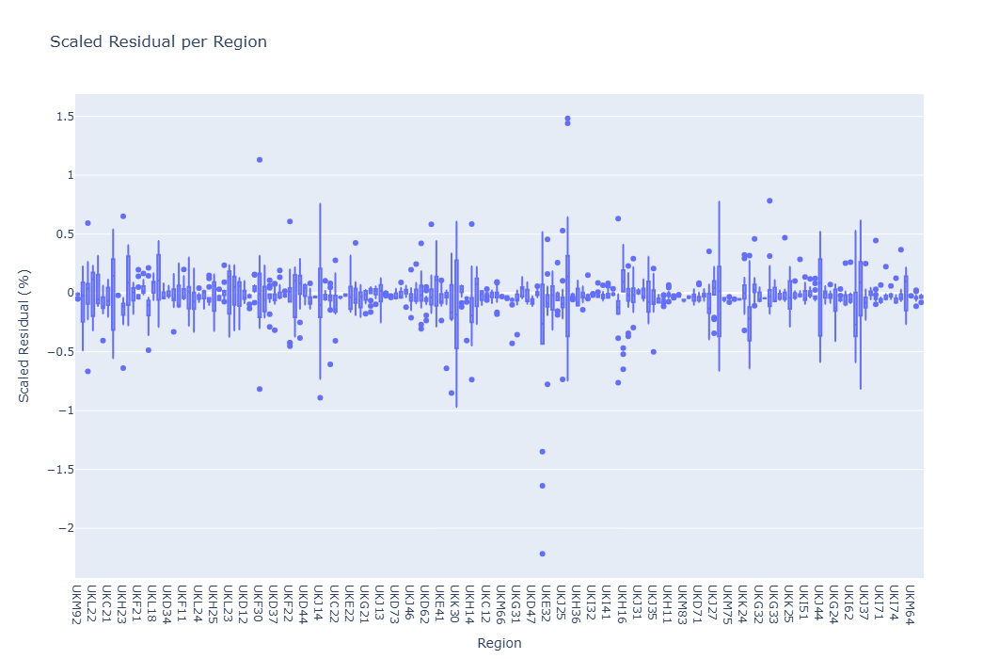

In [22]:

fig = px.box(gb_data, x="nuts_cd", y="residual_mwp", title="Residual per Region", hover_data=["nuts_cd", "year"])
fig.update_layout(xaxis_title='Region', yaxis_title='Residual (MW)', autosize=False, width=1000, height=700)
# fig.update_layout(autosize=False, width=700, height=700)
fig.show(config=config)

fig = px.box(gb_data, x="nuts_cd", y="residual_percentage", title="Residual per Region")
fig.update_layout(xaxis_title='Region', yaxis_title='Residual (%)', autosize=False, width=1000, height=700)
# fig.update_layout(autosize=False, width=700, height=700)
fig.show(config=config)

fig = px.box(gb_data, x="nuts_cd", y="scaled_residual_mwp", title="Scaled Residual per Region")
fig.update_layout(xaxis_title='Region', yaxis_title='Scaled Residual (MW)', autosize=False, width=1000, height=700)
# fig.update_layout(autosize=False, width=700, height=700)
fig.show(config=config)

fig = px.box(gb_data, x="nuts_cd", y="scaled_residual_percentage", title="Scaled Residual per Region")
fig.update_layout(xaxis_title='Region', yaxis_title='Scaled Residual (%)', autosize=False, width=1000, height=700)
# fig.update_layout(autosize=False, width=700, height=700)
fig.show(config=config)

# fig = px.box(gb_data, x="country", y="MAPE (%)", title="MAPE per Country")
# fig.update_layout(xaxis_title='Country', yaxis_title='MAPE (%)', autosize=False, width=1000, height=700)
# # fig.update_layout(autosize=False, width=700, height=700)
# fig.show(config=config)

### Residual by year

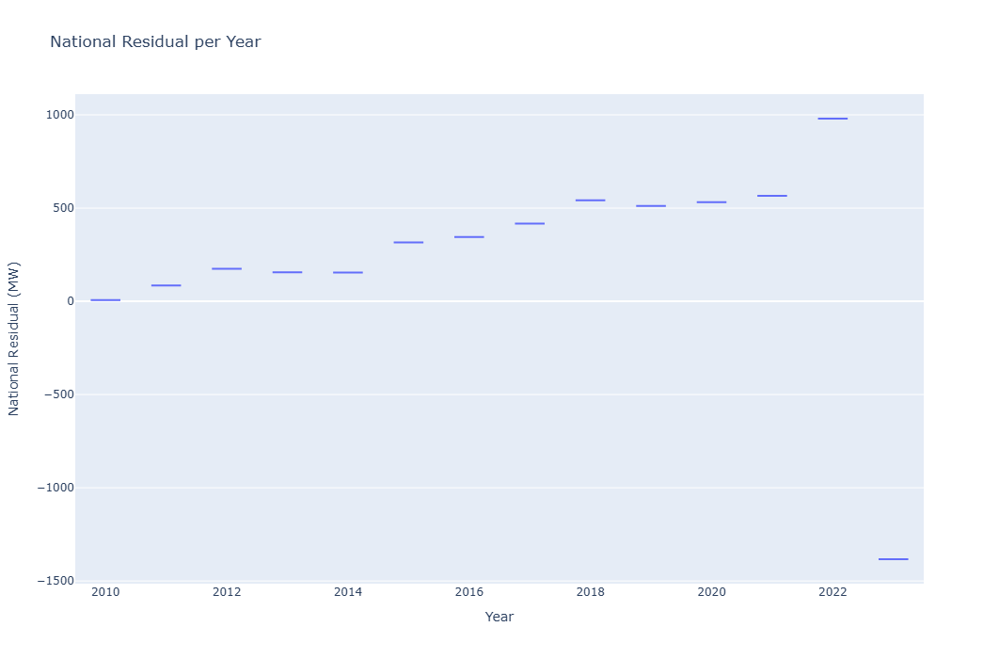

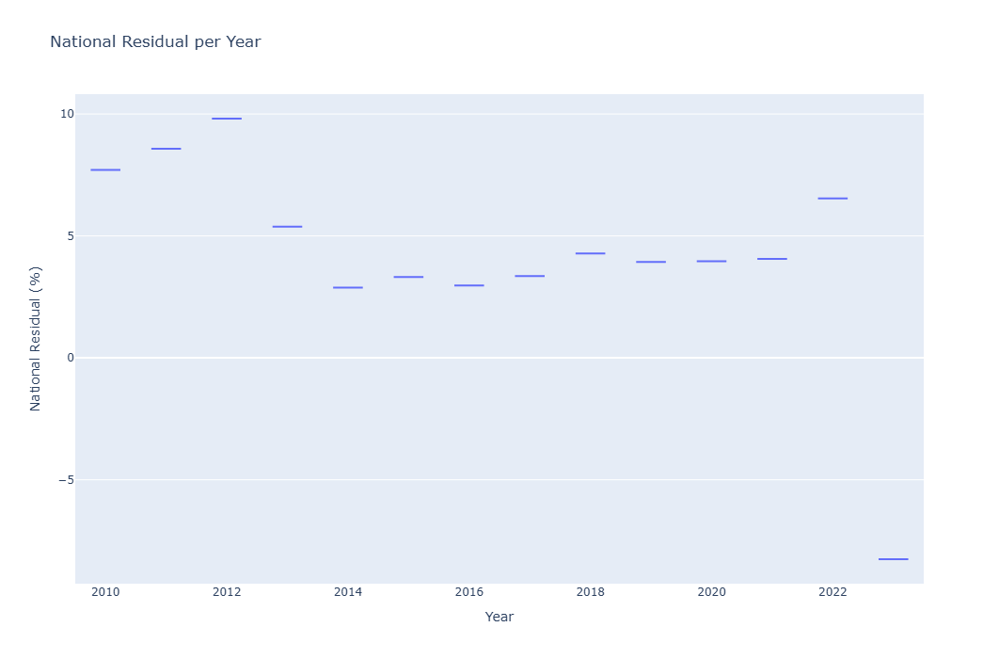

In [23]:
fig = px.box(gb_data, x="year", y="national_residual_mwp",title="National Residual per Year",  hover_data=["national_residual_mwp", "country"])
fig.update_layout(xaxis_title='Year', yaxis_title='National Residual (MW)', autosize=False, width=900, height=700)
# fig.update_layout(autosize=False, width=700, height=700)
fig.show(config=config)

fig = px.box(gb_data, x="year", y="national_residual_percentage",title="National Residual per Year",  hover_data=["national_residual_percentage", "country"])
fig.update_layout(xaxis_title='Year', yaxis_title='National Residual (%)', autosize=False, width=900, height=700)
# fig.update_layout(autosize=False, width=700, height=700)
fig.show(config=config)

### Actual vs predicted regional capacity by region and year

/gb_pv_capacity_model/models/model_training_norm.py:1280: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



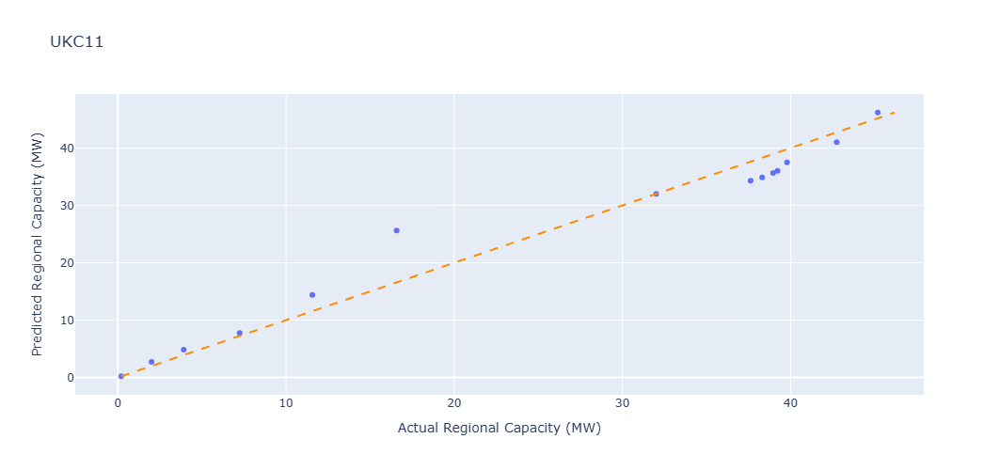

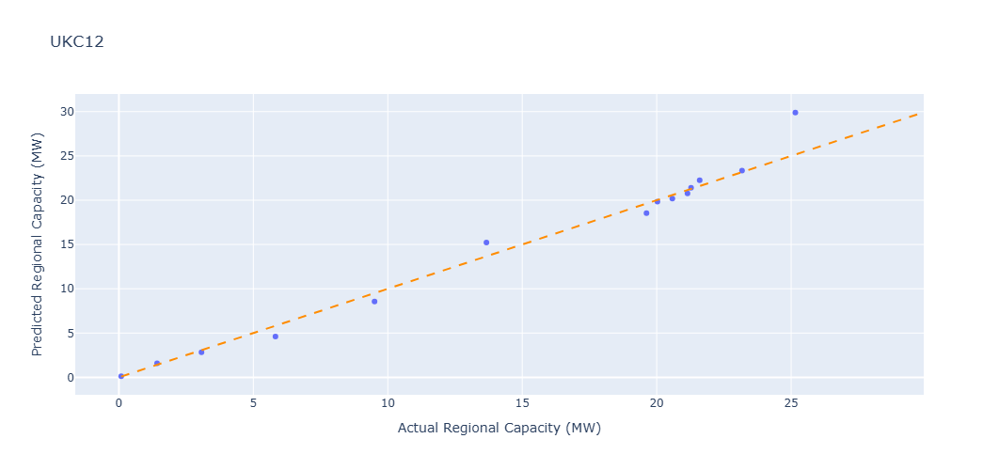

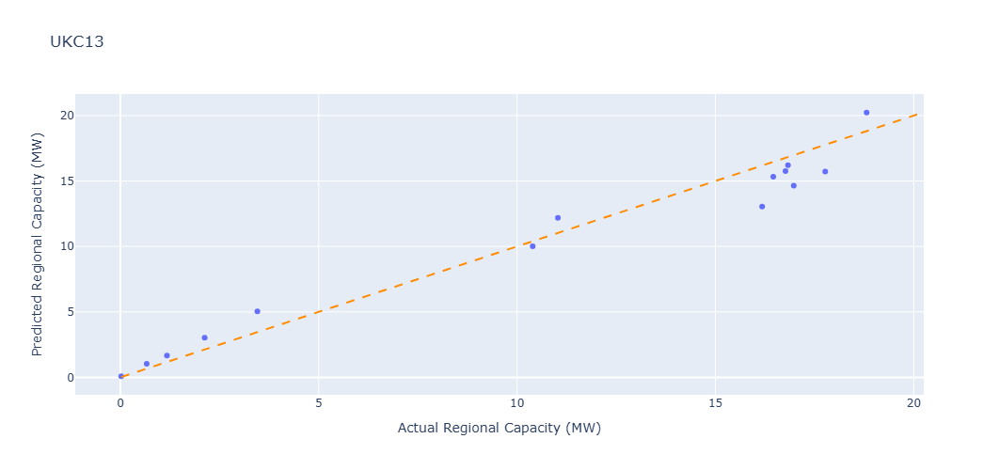

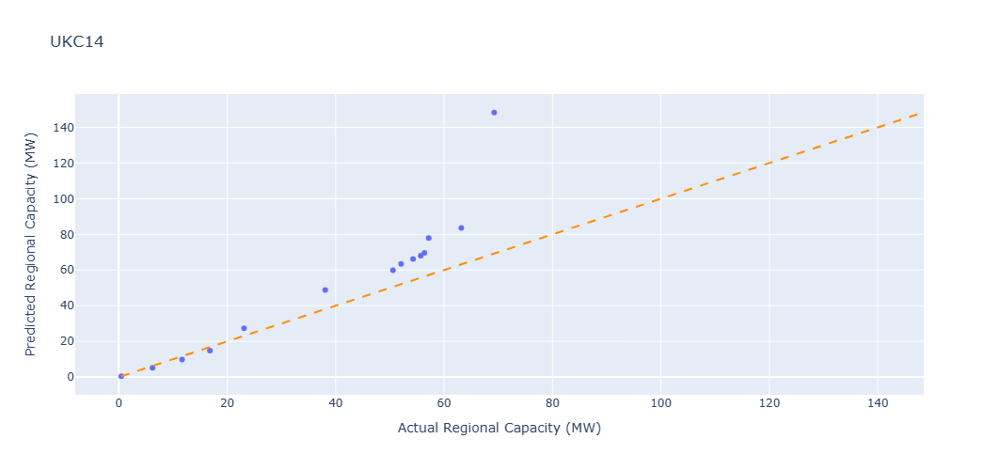

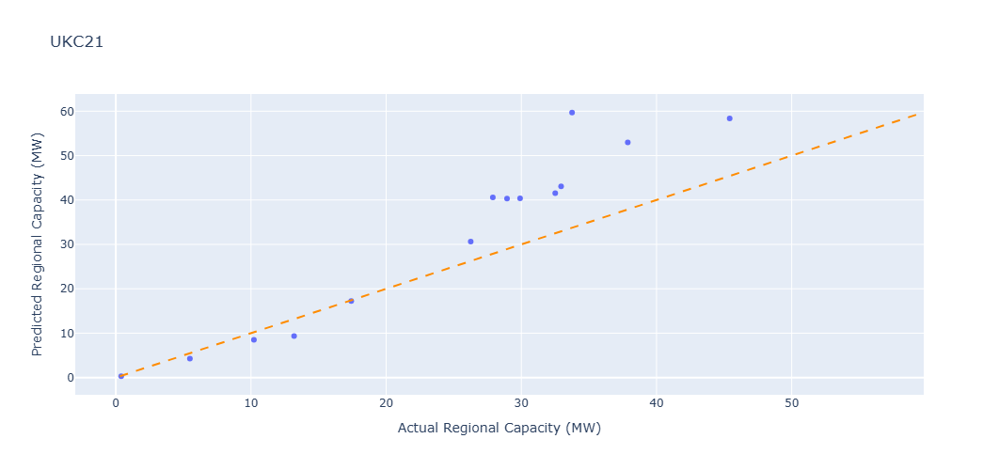

...

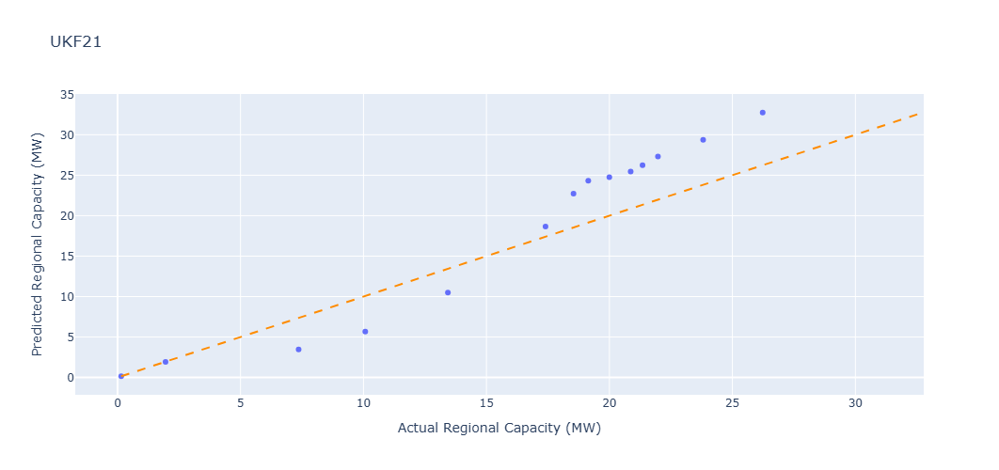

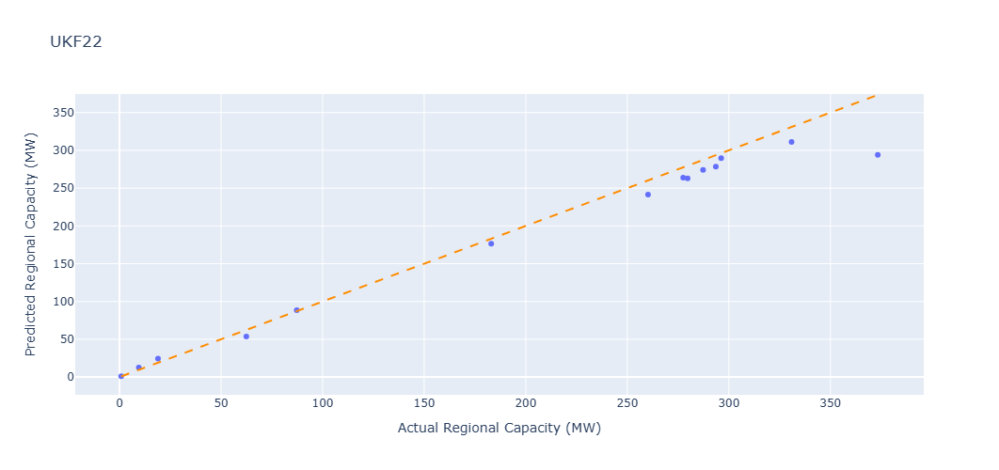

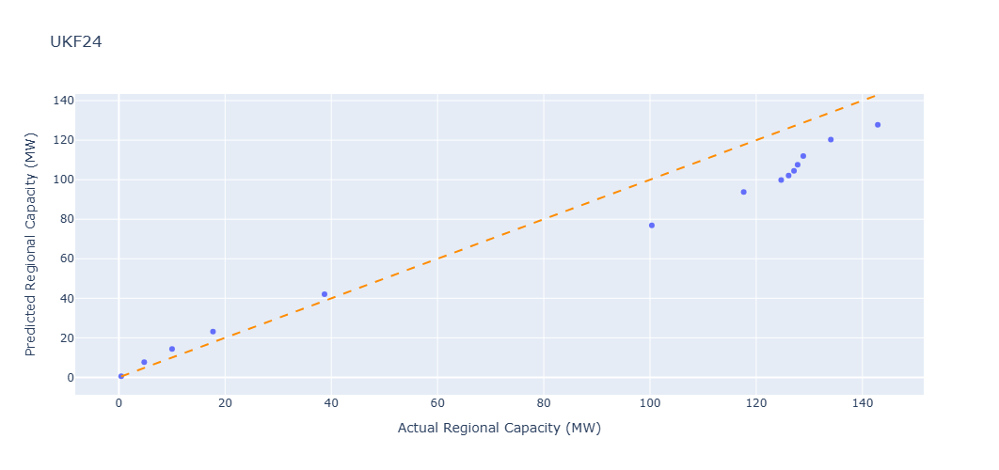

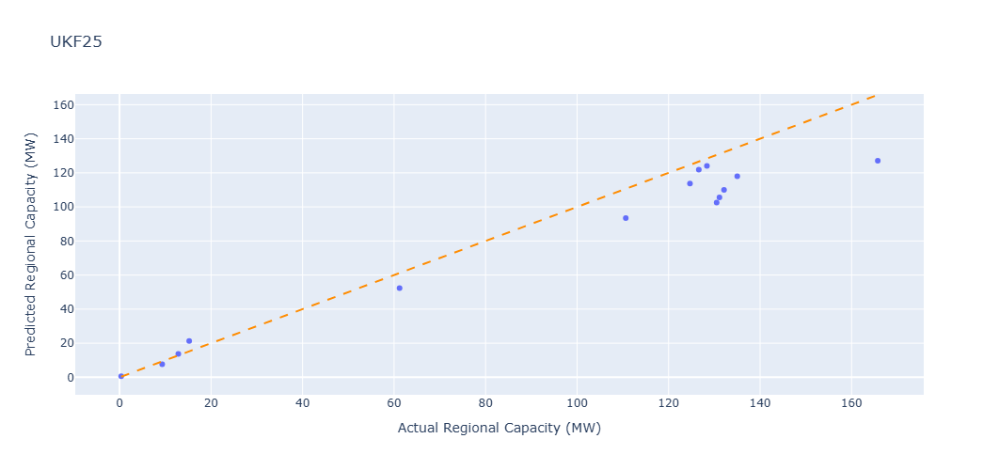

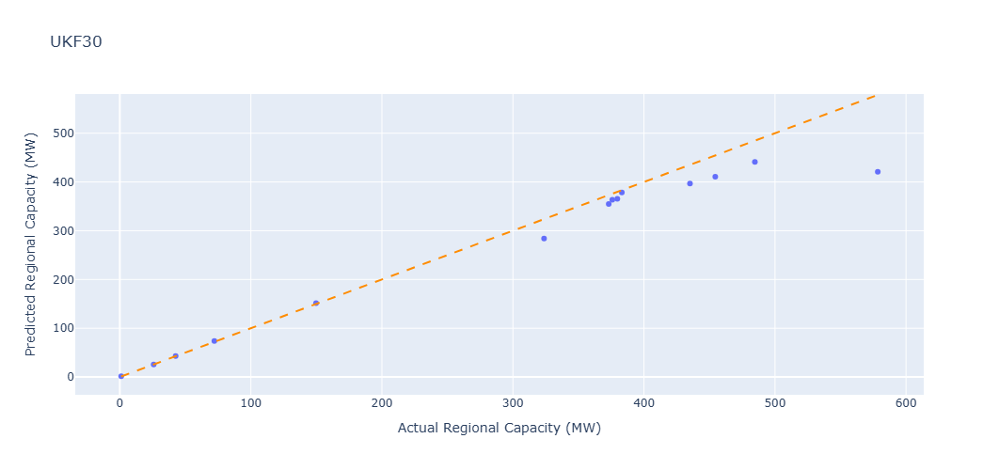

In [24]:
plot_actual_vs_predicted_regional_capacity_by_factor(gb_data, by_factor=True, factor='nuts_cd', scaled=False, unit='MW')

/gb_pv_capacity_model/models/model_training_norm.py:1280: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



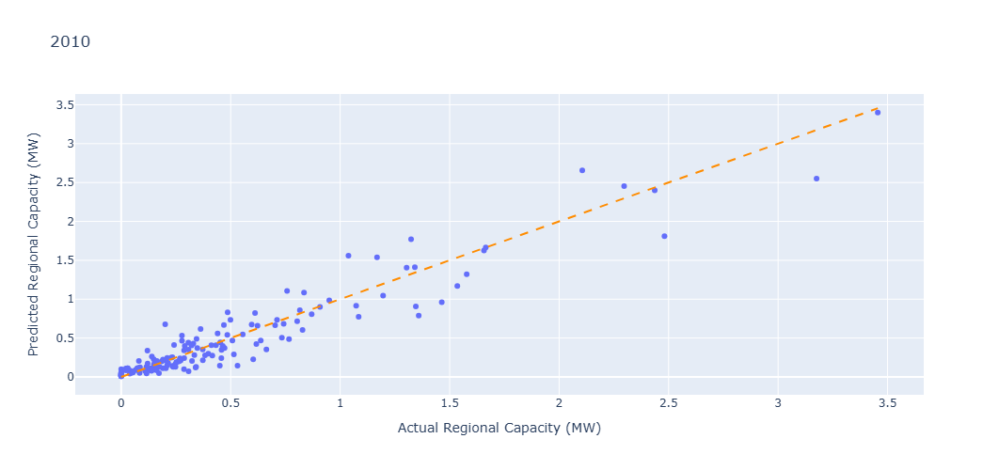

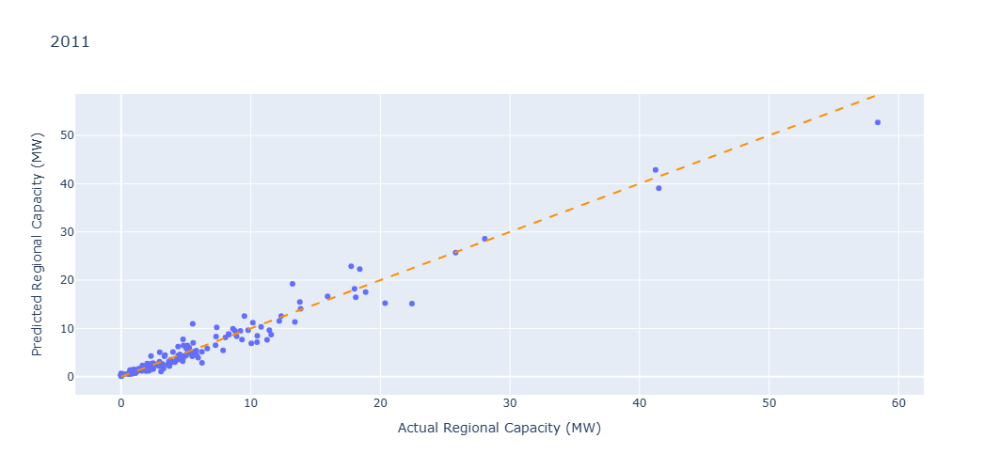

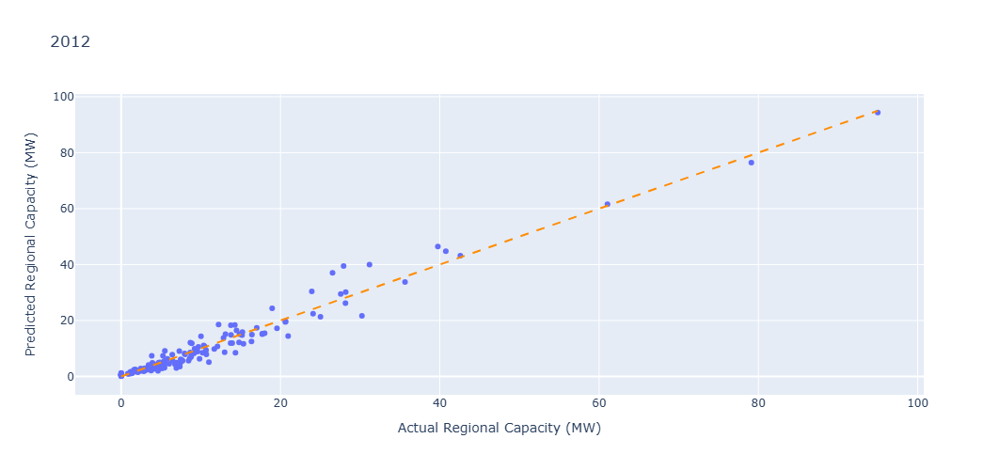

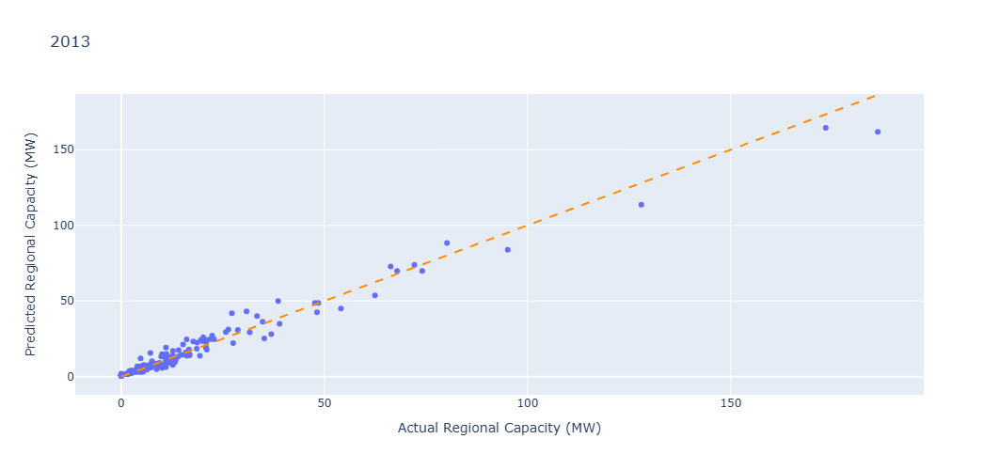

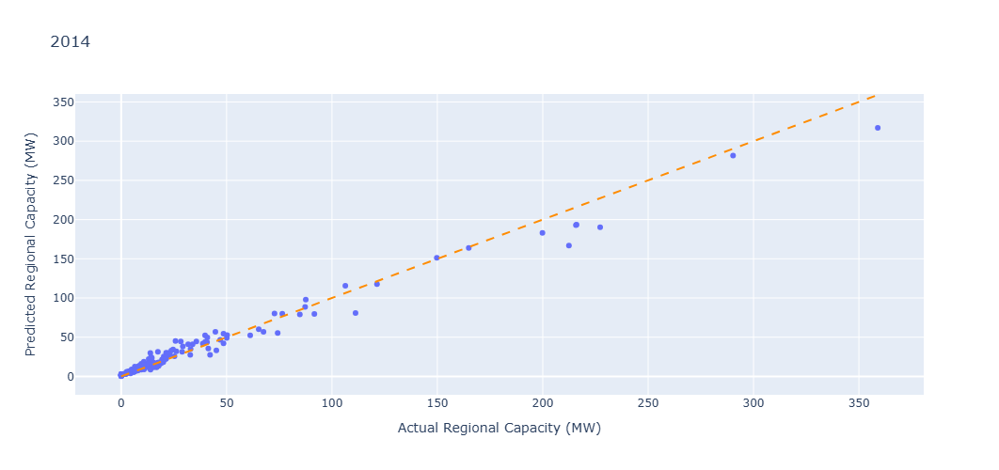

...

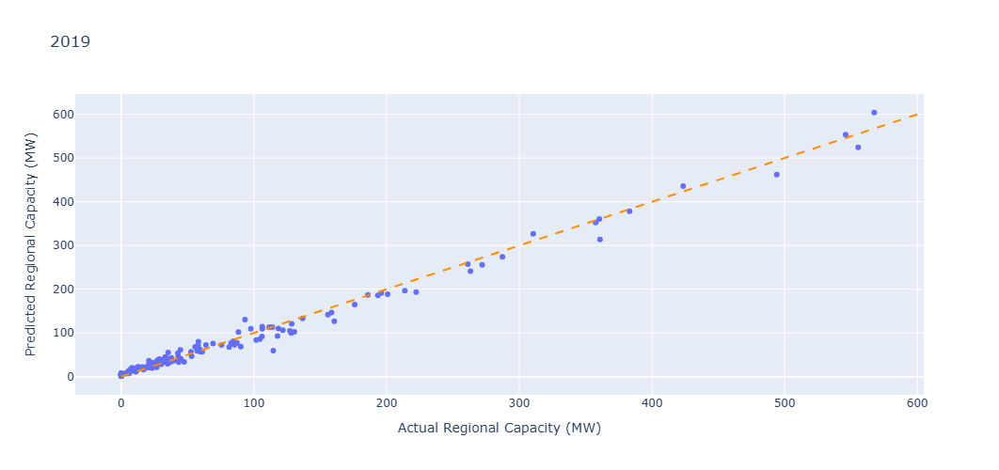

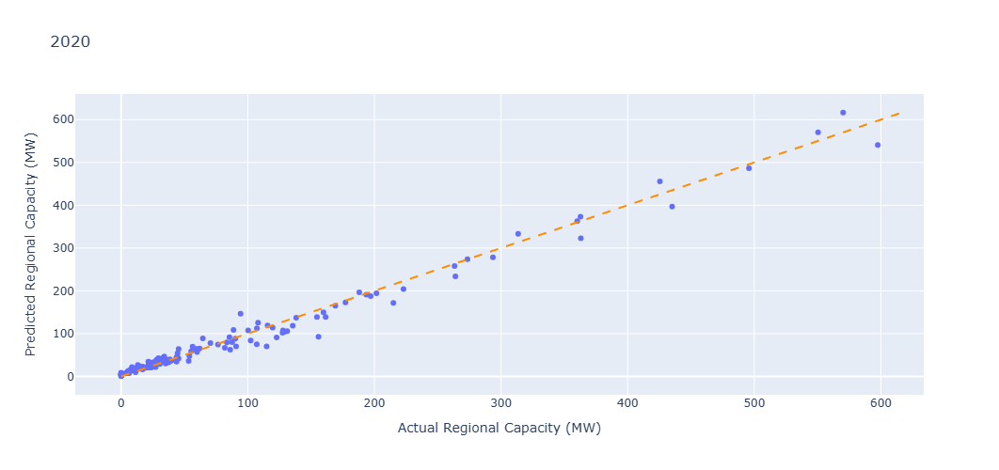

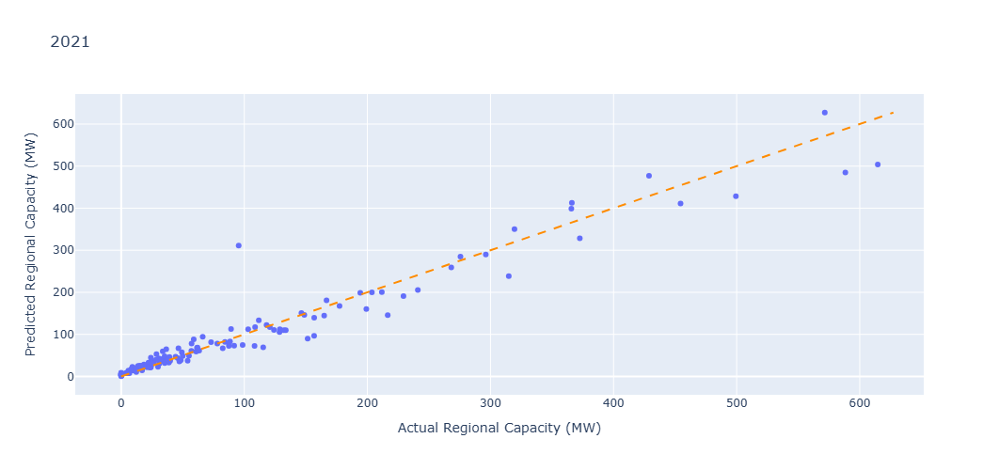

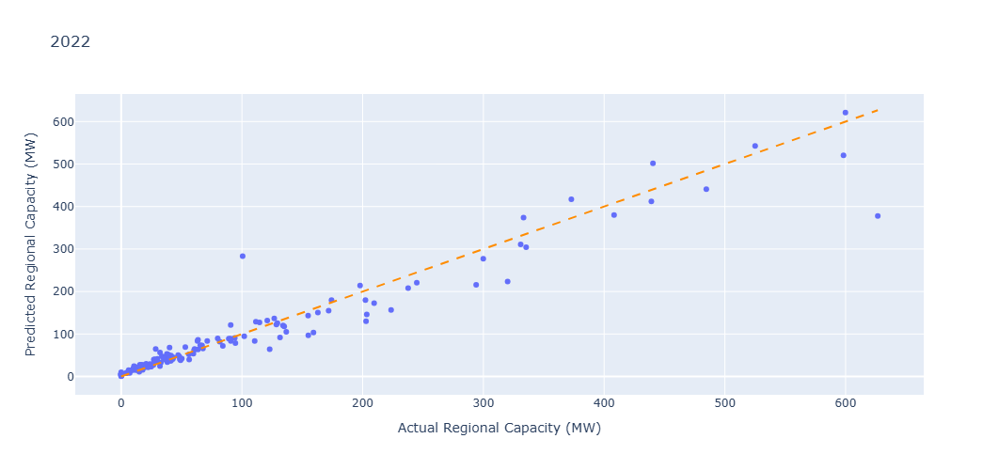

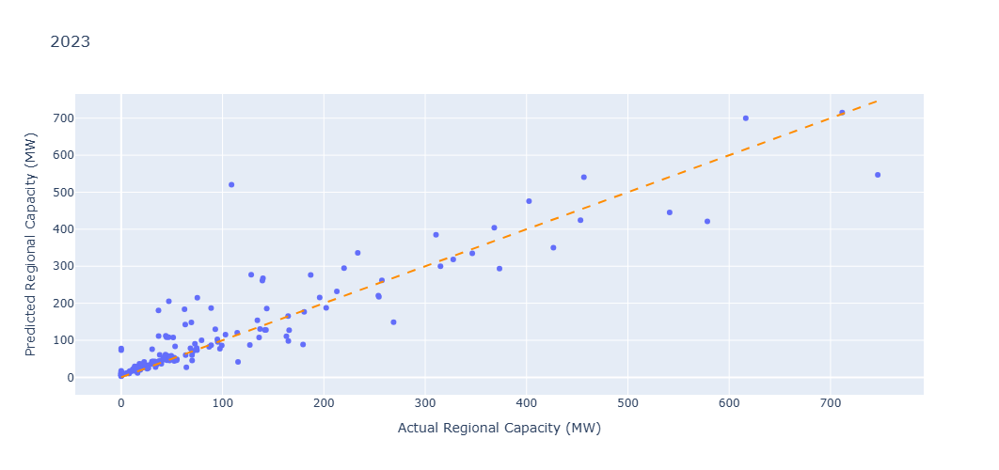

In [25]:
plot_actual_vs_predicted_regional_capacity_by_factor(gb_data, by_factor=True, factor='year', scaled=False, unit='MW')

### Results: error metrics

#### Results (regional) in MW

In [17]:
training_results_mw(gb_data)

Results for the unscaled data
R2 training score is  0.9874296571852528
R2 test score is  0.8948972751731458
The MSE is: 1701.3867566236227
The MAE is: 20.26784535374678
RMSE is: 41.247869722248964
MAPE is: 4866986003128271.0
Results for the scaled data
R2 training score is  0.9882004792149655
R2 test score is  0.9005282985161316
The MSE is: 1610.2326161598287
The MAE is: 19.93700529028948
RMSE is: 40.127703848586066
MAPE is: 4751364603360748.0


#### Results (national)

Before scaling

In [26]:
gb_results(gb_data)

R2 test score is  0.9896153283161709
The MSE is: 322248.2238625896
The MAE is: 440.67330274613226
RMSE is: 567.6691147689731
MAPE is: 0.05357443631952004


After scaling

In [27]:
gb_scaled_results(gb_data)

R2 test score is  0.9999999999999941
The MSE is: 1.813218813960355e-07
The MAE is: 0.0003048982400183523
RMSE is: 0.00042581907119812695
MAPE is: 3.377538505173464e-08
